# Library

In [46]:
import pandas as pd
import numpy as np
import PreProcessingText as ppt
from collections import Counter, defaultdict
import seaborn as sns
from wordcloud import WordCloud
import networkx as nx
import matplotlib.pyplot as plt
import squarify
from transformers import pipeline
from tqdm import tqdm
from bertopic import BERTopic
from sentence_transformers import SentenceTransformer, util
from bertopic.representation import MaximalMarginalRelevance, KeyBERTInspired
from sklearn.feature_extraction.text import CountVectorizer
from keybert import KeyBERT
from umap import UMAP
import hdbscan
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import csv
from bertopic.vectorizers import ClassTfidfTransformer
from sklearn.cluster import KMeans
from scipy.spatial import distance
from scipy.cluster import hierarchy as sch
from sklearn.cluster import AgglomerativeClustering

# Read csv

In [3]:
df = pd.read_csv('../merged_data.csv')
print(df.shape)
df.head()

(292783, 12)


,name_board,creator_thread,creator_id_thread,name_thread,created_on,registration_date,total_posts,reputation,creator_post,creator_id_post,content,created_on_post
0,Tor,blonger,32544,"Tor shrinked of about 13,5% but you can contri...",2020-01-09,1900-01-01 00:00:00,0.0,0.0,[deleted],37,[removed],2019-10-16
1,Tor,blonger,32544,"Tor shrinked of about 13,5% but you can contri...",2020-01-09,1900-01-01 00:00:00,0.0,0.0,blonger,32544,The Torproject recently ***LINK***announced[ht...,2019-10-30
2,Tor,Xanitforthecash,2467,should I run a tor node,2020-01-09,2018-03-21 00:00:00,88.0,9.0,rswz,32661,***LINK***http://ea5faa5po25cf7fb.onion/projec...,2019-10-16
3,Tor,Xanitforthecash,2467,should I run a tor node,2020-01-09,2018-03-21 00:00:00,88.0,9.0,ChemistWeb,33150,if someone will do something bad from that ip ...,2019-10-16
4,Tor,Xanitforthecash,2467,should I run a tor node,2020-01-09,2018-03-21 00:00:00,88.0,9.0,Xanitforthecash,2467,I already leave tor open for a good amount of ...,2019-10-16


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 292783 entries, 0 to 292782
Data columns (total 12 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   name_board         292783 non-null  object 
 1   creator_thread     291854 non-null  object 
 2   creator_id_thread  292783 non-null  int64  
 3   name_thread        292783 non-null  object 
 4   created_on         292783 non-null  object 
 5   registration_date  283901 non-null  object 
 6   total_posts        283901 non-null  float64
 7   reputation         283901 non-null  float64
 8   creator_post       292783 non-null  object 
 9   creator_id_post    292783 non-null  int64  
 10  content            292783 non-null  object 
 11  created_on_post    292783 non-null  object 
dtypes: float64(2), int64(2), object(8)
memory usage: 26.8+ MB


In [4]:
df.describe()

,creator_id_thread,total_posts,reputation,creator_id_post
count,292783.000000,283901.000000,283901.000000,292783.000000
mean,10955.409143,256.476825,110.806869,13859.933620
std,11966.111899,985.677180,520.127893,13231.876301
min,-1.000000,0.000000,-1313.000000,1.000000
25%,1759.000000,4.000000,0.000000,2370.000000
50%,6686.000000,25.000000,3.000000,9080.000000
75%,15491.000000,118.000000,23.000000,22793.000000
max,47346.000000,10406.000000,4790.000000,47532.000000


In [5]:
df.describe(include='object')

,name_board,creator_thread,name_thread,created_on,registration_date,creator_post,content,created_on_post
count,292783,291854,292783,292783,283901,292783,292783,292783
unique,382,23805,68931,25,577,42682,270239,629
top,DarkNetMarkets,[deleted],#FREE GIVE AWAY: 1000X XTC PILLS worth 950 EUR...,2020-01-08,1900-01-01 00:00:00,[deleted],[removed],2019-08-08
freq,49716,3919,342,101604,40879,4499,13198,26736


In [6]:
df.isnull().sum()

name_board              0
creator_thread        929
creator_id_thread       0
name_thread             0
created_on              0
registration_date    8882
total_posts          8882
reputation           8882
creator_post            0
creator_id_post         0
content                 0
created_on_post         0
dtype: int64

# Pre-Process Text

In [7]:
df['name_thread'].value_counts()

name_thread
#FREE GIVE AWAY: 1000X XTC PILLS worth 950 EURO GUESS NUMBER BITWEEN 1 AND 500                         342
Obtain Vendor Badge                                                                                    291
Giving away free 125g Gorilla Glue worth 725-1400 euros (IMPORTANT UPDATE!)                            270
COCAINE GIVE AWAY WE ARE GIVING AWAY 30G COLOMBIAN COCAINE COMMENT TO ENTER! ENDS 16/09/2019 1PM by    223
GIVEAWAY - 14G MORROCCAN HASHISH                                                                       222
                                                                                                      ... 
/d/ketamine is now live!                                                                                 1
Is there a way to view cancelled or refunded or orders after dispute?                                    1
AXS MARKET                                                                                               1
[ROLEX]Buy and get 50% mo

In [3]:
# 15 Minutes
df['name_thread'] = df['name_thread'].apply(ppt.clean_sentences)
df['name_thread'].value_counts()

name_thread
FREE give away XTC PILLS worth EURO guess number bitween and                          342
Obtain Vendor Badge                                                                   291
giveaway of Dark Star worth                                                           272
giving away free Gorilla Glue worth euros IMPORTANT update                            270
COCAINE GIVE away we are giving away COLOMBIAN COCAINE COMMENT to enter ends pm by    223
                                                                                     ... 
Benzobananas for mg etizolam liquid QUICK UPDATE on reviews and other news              1
Bitcoin prices went up come and shop at Greenmask                                       1
is there any way to hide specific listings                                              1
se en now the vendor have Dispute on for month now is on vacation status                1
Moroccan Hash Store                                                                     

In [4]:
# Convert numpy array to pandas DataFrame
df_unique = pd.DataFrame(df['name_thread'].unique())

# Save DataFrame to CSV
df_unique.to_csv('preproc_data_name_thread.txt', index=False, header=False)

In [5]:
# 6 Minutes
df['name_thread'] = df['name_thread'].apply(ppt.preprocess_title)
df['name_thread'] = df['name_thread'].apply(ppt.remove_single_characters)
df['name_thread'].value_counts()

name_thread
FREE give away XTC PILLS worth EURO guess number bitween       342
                                                               337
Obtain Vendor Badge                                            291
giveaway Dark Star worth                                       272
giving away free Gorilla Glue worth euro IMPORTANT update      270
                                                              ... 
Venmo Method crosspost                                           1
id dl info                                                       1
Vendor OrganicValley theorganicvalley important information      1
COCAINE MDA XTC ICE PILLS MORPHINE HYDROMORPH OXYCODONE          1
Vendor review neverpressedrx crosspost                           1
Name: count, Length: 66736, dtype: int64

In [6]:
df.to_csv('cleaned_data_name_thread.csv', index=False)
# Convert numpy array to pandas DataFrame
df_unique = pd.DataFrame(df['name_thread'].unique())

# Save DataFrame to CSV
df_unique.to_csv('name_thread.txt', index=False, header=False)

## Data Visualisation Word

In [29]:
df = pd.read_csv('cleaned_data_name_thread.csv')
word_dict = Counter(' '.join([str(item).lower() for item in df.name_thread.tolist()]).split())
df.head()

,name_board,creator_thread,creator_id_thread,name_thread,created_on,registration_date,total_posts,reputation,creator_post,creator_id_post,content,created_on_post
0,Tor,blonger,32544,Tor shrinked contribute,2020-01-09,1900-01-01 00:00:00,0.0,0.0,[deleted],37,[removed],2019-10-16
1,Tor,blonger,32544,Tor shrinked contribute,2020-01-09,1900-01-01 00:00:00,0.0,0.0,blonger,32544,The Torproject recently ***LINK***announced[ht...,2019-10-30
2,Tor,Xanitforthecash,2467,run tor node,2020-01-09,2018-03-21 00:00:00,88.0,9.0,rswz,32661,***LINK***http://ea5faa5po25cf7fb.onion/projec...,2019-10-16
3,Tor,Xanitforthecash,2467,run tor node,2020-01-09,2018-03-21 00:00:00,88.0,9.0,ChemistWeb,33150,if someone will do something bad from that ip ...,2019-10-16
4,Tor,Xanitforthecash,2467,run tor node,2020-01-09,2018-03-21 00:00:00,88.0,9.0,Xanitforthecash,2467,I already leave tor open for a good amount of ...,2019-10-16


### WordCloud

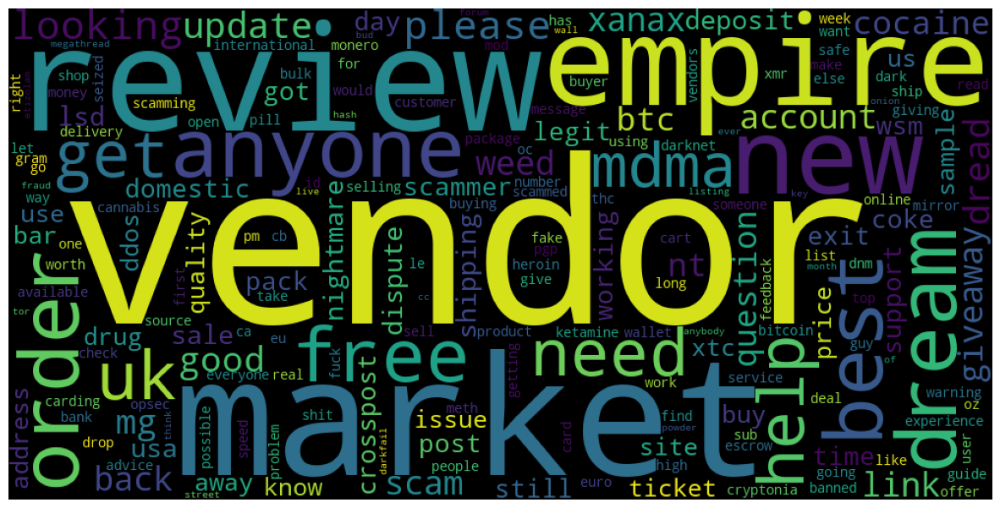

In [11]:
# Count of words in each name_thread
most_common_words = WordCloud(width = 1000, height = 500).generate_from_frequencies(word_dict)
plt.figure(figsize=(15,8))
plt.imshow(most_common_words)
plt.axis("off");

### Barplot & PieChart

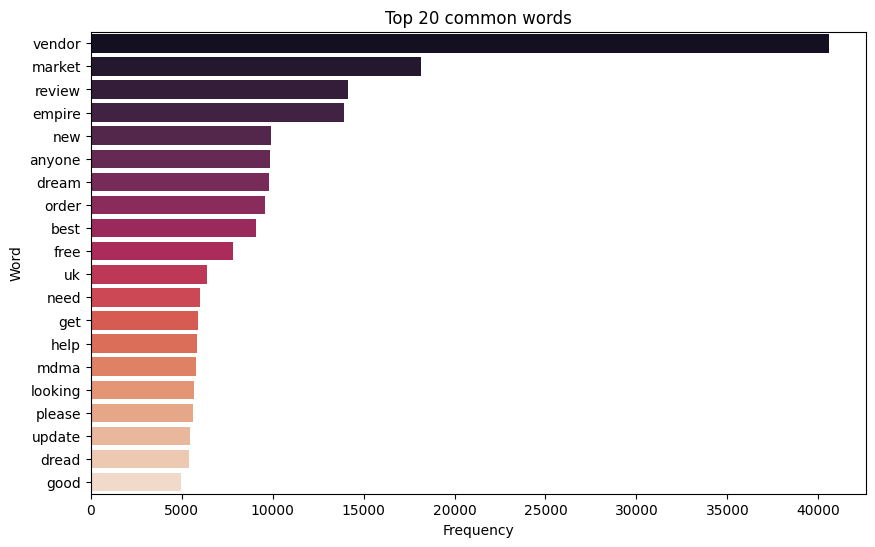

In [3]:
# Most 20 common words
word_freq = word_dict.most_common(20)
word_freq_df = pd.DataFrame(word_freq, columns=['Word', 'Frequency'])

plt.figure(figsize=(10, 6))
sns.barplot(x='Frequency', y='Word', data=word_freq_df, hue='Word', dodge=False, palette='rocket', legend=False)
plt.title('Top 20 common words');

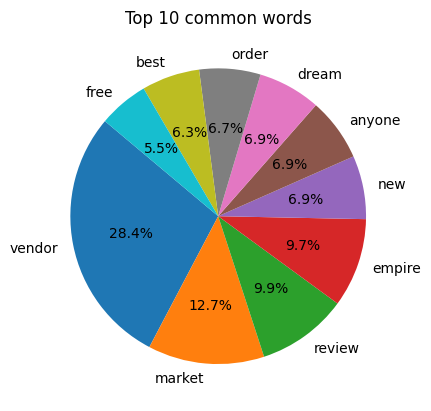

In [4]:
plt.pie(word_freq_df['Frequency'][:10], labels=word_freq_df['Word'][:10], autopct='%1.1f%%', startangle=140)
plt.title('Top 10 common words');

C:\Users\dommy\AppData\Local\Temp\ipykernel_4348\1552728134.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Frequency', y='Word', data=word_freq_df, palette='viridis')


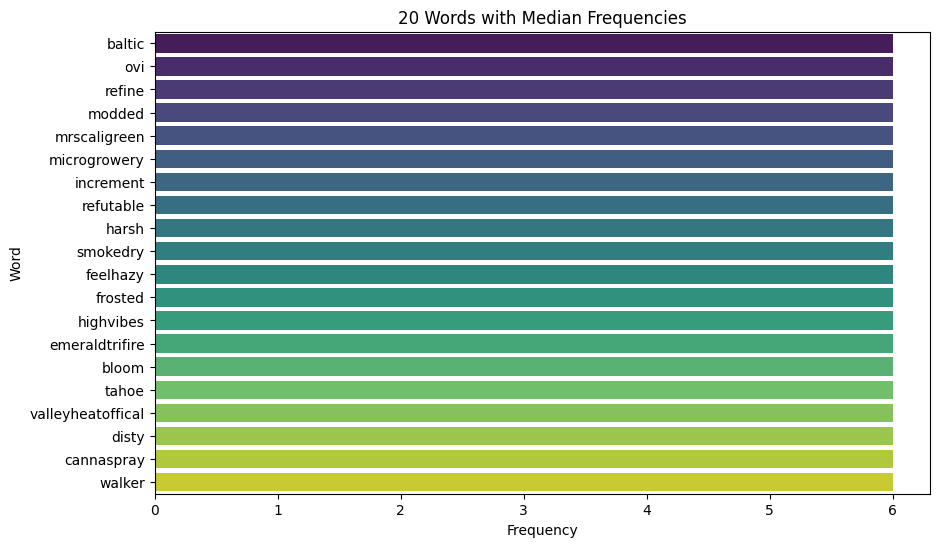

In [20]:
sorted_word_freq = word_dict.most_common()
total_words = len(sorted_word_freq)
middle_index = total_words // 2
middle_words = sorted_word_freq[middle_index - 10:middle_index + 10]
word_freq_df = pd.DataFrame(middle_words, columns=['Word', 'Frequency'])
plt.figure(figsize=(10, 6))
sns.barplot(x='Frequency', y='Word', data=word_freq_df, palette='viridis')
plt.title('20 Words with Median Frequencies');

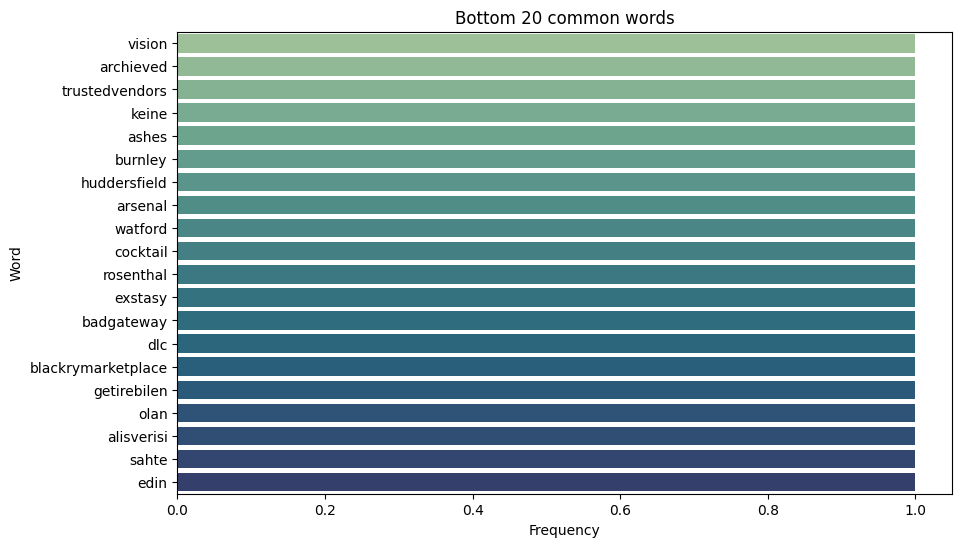

In [22]:
# Bottom 20 common words
word_freq = word_dict.most_common()[:-21:-1]
word_freq_df = pd.DataFrame(word_freq, columns=['Word', 'Frequency'])

plt.figure(figsize=(10, 6))
sns.barplot(x='Frequency', y='Word', data=word_freq_df, hue='Word', dodge=False, palette='crest', legend=False)
plt.title('Bottom 20 common words');

### Distribution of Words

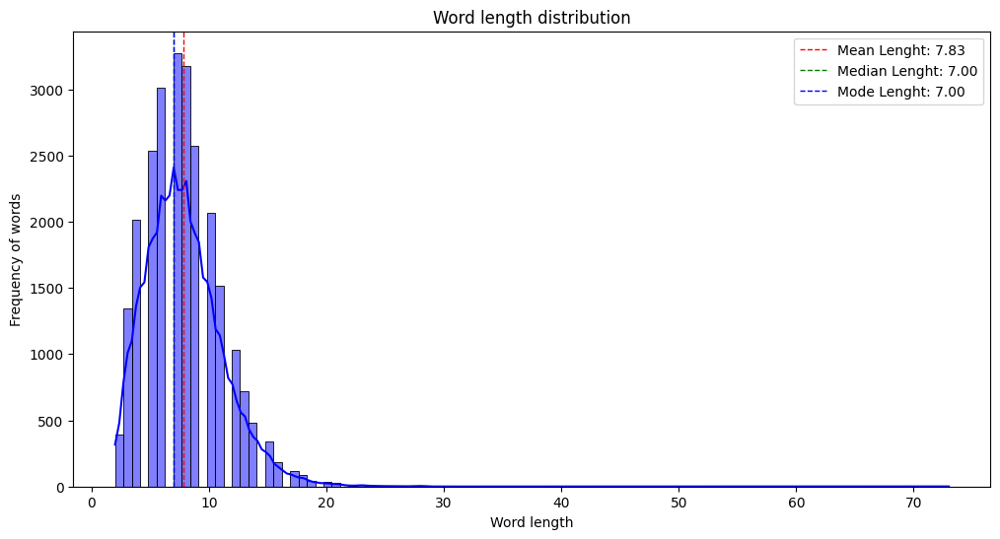

In [16]:
word_lengths = [len(word) for word in word_dict.keys()]
mean_length = np.mean(word_lengths)
median_length = np.median(word_lengths)
mode_length = np.argmax(np.bincount(word_lengths))
plt.figure(figsize=(12, 6))
sns.histplot(word_lengths, bins=100, kde=True, color='blue')
plt.axvline(mean_length, color='red', linestyle='dashed', linewidth=1, label=f'Mean Lenght: {mean_length:.2f}')
plt.axvline(median_length, color='green', linestyle='dashed', linewidth=1, label=f'Median Lenght: {median_length:.2f}')
plt.axvline(mode_length, color='blue', linestyle='dashed', linewidth=1, label=f'Mode Lenght: {mode_length:.2f}')
plt.title('Word length distribution')
plt.xlabel('Word length')
plt.ylabel('Frequency of words')
plt.legend();

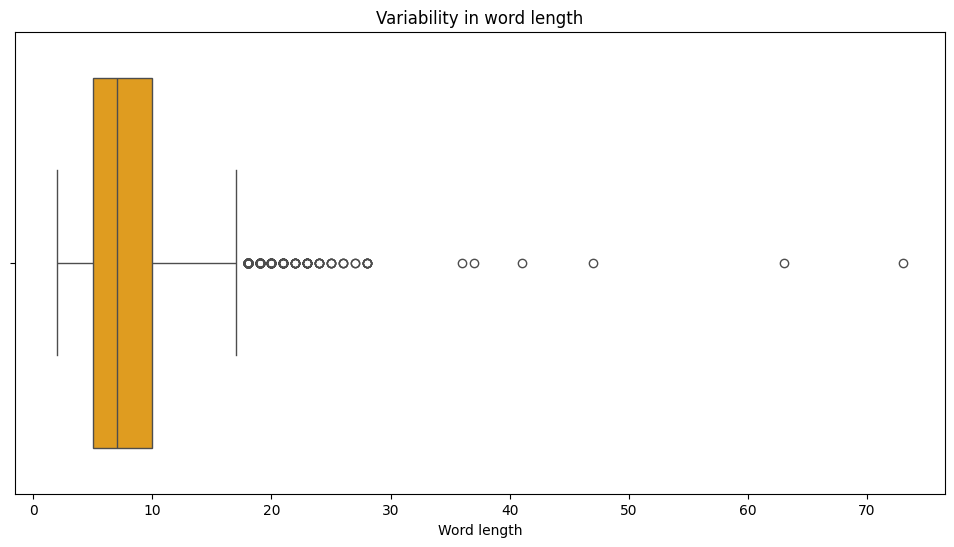

In [18]:
plt.figure(figsize=(12, 6))
sns.boxplot(x=word_lengths, color='orange')
plt.title('Variability in word length')
plt.xlabel('Word length');

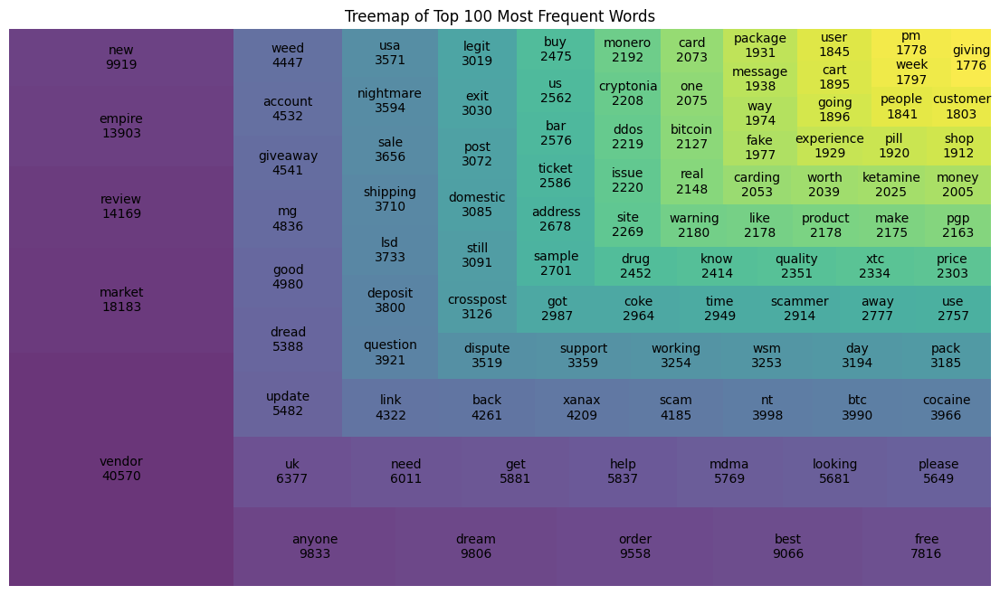

In [10]:
most_common_words = word_dict.most_common(100)
words, frequencies = zip(*most_common_words)
sizes = [freq for freq in frequencies]
labels = [f'{word}\n{freq}' for word, freq in most_common_words]

plt.figure(figsize=(14, 8))
squarify.plot(sizes=sizes, label=labels, alpha=0.8, color=sns.color_palette('viridis', len(sizes)))
plt.axis('off')
plt.title('Treemap of Top 100 Most Frequent Words');

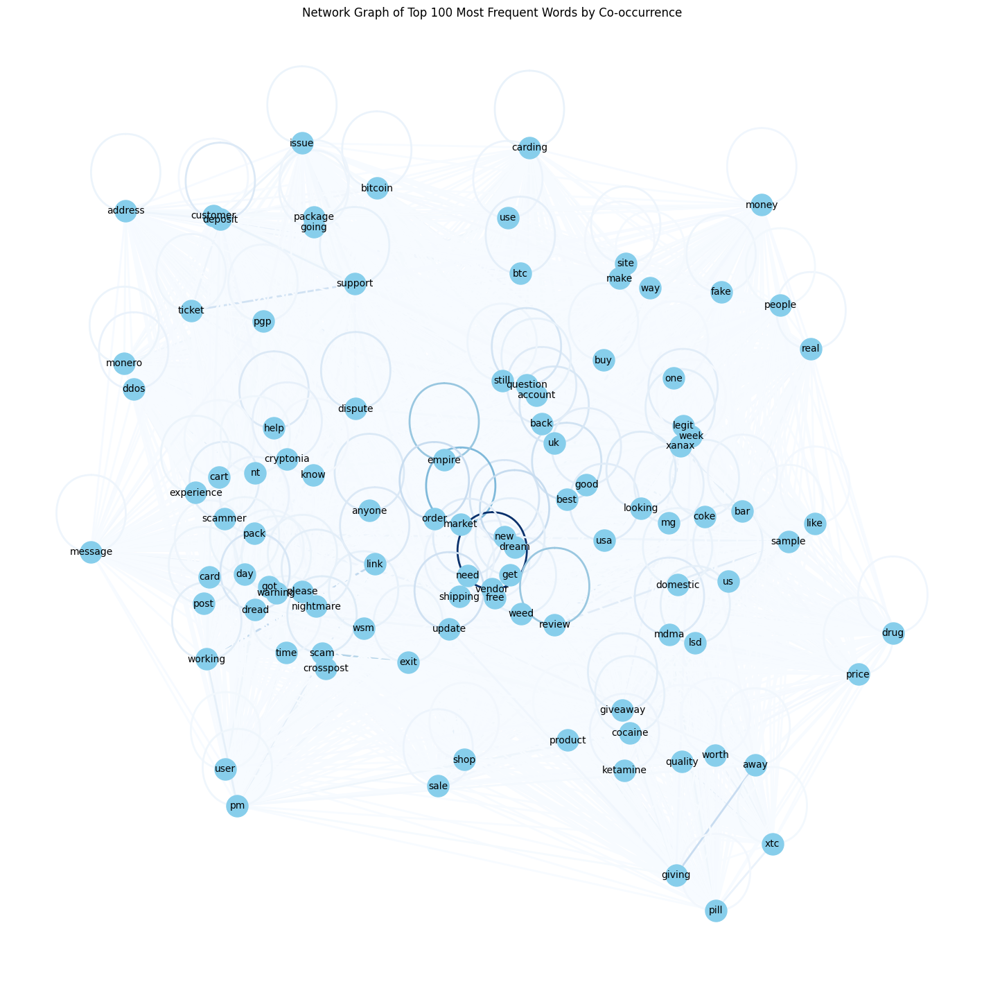

In [13]:
top_words = set(words)

# Calculate co-occurrences
window_size = 5
co_occurrence = defaultdict(int)

# Tokenize the text
text = ' '.join([str(item).lower() for item in df.name_thread.tolist()])
tokens = text.split()

# Sliding window to count co-occurrences
for i in range(len(tokens) - window_size + 1):
    window = tokens[i:i + window_size]
    for i, word1 in enumerate(window):
        if word1 in top_words:
            for j, word2 in enumerate(window):
                if i != j and word2 in top_words:
                    pair = tuple(sorted([word1, word2]))
                    co_occurrence[pair] += 1

# Create the graph
G = nx.Graph()

# Add edges based on co-occurrence
for (word1, word2), count in co_occurrence.items():
    if count > 1:  # Include only pairs with more than 1 co-occurrence
        G.add_edge(word1, word2, weight=count)

plt.figure(figsize=(14, 14))
pos = nx.spring_layout(G, k=0.15, iterations=20)
weights = [G[u][v]['weight'] for u, v in G.edges()]
nx.draw(G, pos, with_labels=True, node_size=500, node_color='skyblue', edge_color=weights, width=2.0, edge_cmap=plt.cm.Blues, font_size=10)
plt.title('Network Graph of Top 100 Most Frequent Words by Co-occurrence');

# Modeling Thread Feature

## 1° Approach: Zero-shot Classification (Too Time)

In [3]:
df = pd.read_csv('cleaned_data_name_thread.csv')
df_intent = pd.read_csv('../../intent_crime.csv')
list_intents = df_intent['intent'].to_list()
pipe = pipeline("zero-shot-classification", model='cross-encoder/nli-roberta-base')
df = df.dropna(subset=['name_thread'])

df = ppt.zero_shot_process_threads(df[:30000], pipe, list_intents, 'output_file.csv')

c:\Users\dommy\OneDrive\Documenti\GSoC - Final\GSoC\Analyze_files\Completed\PreProcessingText.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'top_label_{i}'] = None
c:\Users\dommy\OneDrive\Documenti\GSoC - Final\GSoC\Analyze_files\Completed\PreProcessingText.py:149: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'top_score_{i}'] = None
c:\Users\dommy\OneDrive\Documenti\GSoC - Final\GSoC\Analyze_files\Completed\PreProcessingText.py:148: SettingWithCopyWarning: 
A value is trying to be set on a 

In [2]:
dd = pd.read_csv('output_file.csv')
dd['top_label_1'].value_counts()

top_label_1
tor problems         6542
drugs                6362
find vendor          4713
fraud                2984
update site          1371
sell drugs           1209
no crime             1161
stolen goods         1021
hacking               733
counterfeit money     709
corruption            533
check sale            402
espionage             391
trafficking           354
burglary              243
buy drugs             194
gun                   163
order medication      159
fake IDs              140
murder                 86
identity theft         85
government attack      80
genocide               79
bombing                74
pedophilia             53
abduction              33
rape                   30
arson                  29
buy weapons            28
kidnapping             22
child abuse            10
organ trafficking       5
terrorism               2
Name: count, dtype: int64

In [7]:
dd.drop_duplicates(subset=['name_thread'], keep='first', inplace=True)
dd[['name_thread', 'top_label_1', 'top_score_1', 'top_label_2', 'top_score_2']].head(50)

,name_thread,top_label_1,top_score_1,top_label_2,top_score_2
0,Tor shrinked contribute,tor problems,0.284519,fraud,0.073563
2,run tor node,arson,0.120247,hacking,0.071540
7,Tor browser,hacking,0.166554,fraud,0.110060
9,UPDATED tor security guide crosspost,update site,0.408131,arson,0.048836
10,CostcoRotisserieChicken spreading FUD Let Smas...,corruption,0.208999,fraud,0.130308
11,got banned darknetmarkets simply trying help c...,tor problems,0.211538,hacking,0.157267
12,hiring Shadow Simulation Developer,tor problems,0.111187,hacking,0.092769
13,New release tor browser,update site,0.086229,fraud,0.071933
14,Onion Service operator mitigate DDoS Attacks a...,tor problems,0.150861,hacking,0.131263
17,noscript defaulting ALL Options Enabled NOT sa...,tor problems,0.155056,find vendor,0.056707


## 2° Approach: TF-IDF - Not Accuracy

In [ ]:
df = pd.read_csv('cleaned_data_name_thread.csv')
df = df.dropna(subset=['name_thread'])
df = ppt.extract_top_keywords_tfidf(df)
df.to_csv('cleaned_data_name_thread_TF-IDF_top_keywords.csv', index=False)

In [10]:
df_tf_idf = pd.read_csv('cleaned_data_name_thread_TF-IDF_top_keywords.csv')
df_tf_idf.drop_duplicates(subset=['name_thread'], keep='first', inplace=True)
df_tf_idf[['name_thread', 'top_keyword_1', 'top_keyword_2', 'top_keyword_3']].head(50)

,name_thread,top_keyword_1,top_keyword_2,top_keyword_3
0,Tor shrinked contribute,shrinked,contribute,tor
2,run tor node,node,run,tor
7,Tor browser,browser,tor,zzzzz
9,UPDATED tor security guide crosspost,updated,security,tor
10,CostcoRotisserieChicken spreading FUD Let Smas...,costcorotisseriechicken,bugs,smash
11,got banned darknetmarkets simply trying help c...,simply,darknetmarkets,trying
12,hiring Shadow Simulation Developer,simulation,shadow,hiring
13,New release tor browser,release,browser,tor
14,Onion Service operator mitigate DDoS Attacks a...,operator,mitigate,attacks
17,noscript defaulting ALL Options Enabled NOT sa...,wild,vulnerability,release


## 3° Approach: Clustering + SentenceBert

In [2]:
df = pd.read_csv('cleaned_data_name_thread.csv')
df = df.dropna(subset=['name_thread'])
df = df.drop_duplicates(subset=['name_thread'], keep='first')
df.shape[0]

66735

### Agglomerative 6 cluster + tSNE + KeyBERT + Distiluse

2024-06-18 13:26:39,913 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [18:32<00:00,  1.07s/it]
2024-06-18 13:45:12,454 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-18 13:55:02,758 - PreProcessingText - INFO - Starting clustering with Agglomerative Clustering in batches


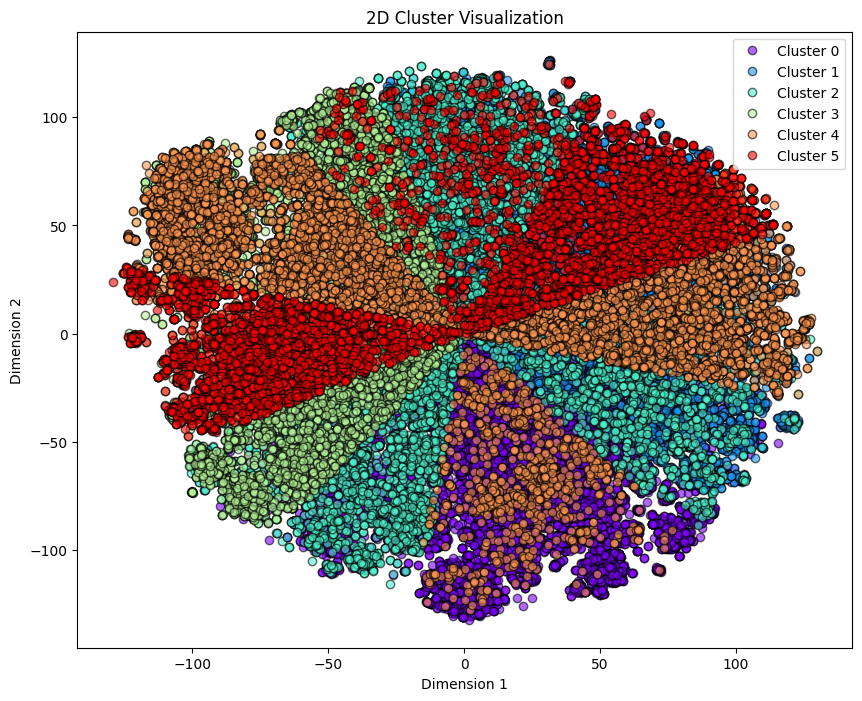

2024-06-18 14:02:04,122 - PreProcessingText - INFO - Extracting keywords from final clusters
2024-06-18 14:02:05,291 - PreProcessingText - INFO - 
Cluster 4, #10593 Elements


--------------------
[('tor', 0.2292), ('daemon', 0.2176), ('ironchat', 0.2149), ('tornado', 0.2037), ('toto', 0.2)]


2024-06-18 14:10:01,931 - PreProcessingText - INFO - 
Cluster 0, #16445 Elements


[('daemon wiki', 0.3403), ('recover monero', 0.2806), ('tor shrinked', 0.2762), ('daemon throw', 0.2757), ('mining monero', 0.2704)]
--------------------
--------------------
[('bitcoinfrauder', 0.2687), ('bitcoinlaundering', 0.2647), ('bitcoinpostage', 0.2581), ('torum', 0.2458), ('tor', 0.244)]


2024-06-18 14:22:17,483 - PreProcessingText - INFO - 
Cluster 2, #10043 Elements


[('tor browser', 0.3967), ('bitcoins tor', 0.3878), ('tor node', 0.3769), ('node tor', 0.3691), ('hack tor', 0.3621)]
--------------------
--------------------
[('darknetmarkets', 0.3673), ('darknetmarketbusts', 0.3665), ('darkwebmarket', 0.3534), ('darknetmarketsnoobs', 0.3506), ('darknetmarketsoz', 0.3476)]


2024-06-18 14:31:02,420 - PreProcessingText - INFO - 
Cluster 1, #11937 Elements


[('banned darknetmarkets', 0.5397), ('nightmaremarket banned', 0.4649), ('banned market', 0.4188), ('crosspost darknetmarkets', 0.4161), ('darknet market', 0.4142)]
--------------------
--------------------
[('nmethylamphetamine', 0.3457), ('methylnethylamphetamine', 0.3419), ('methylenedioxyamphetamine', 0.3385), ('amphetaminehcl', 0.325), ('emeraldpharmacist', 0.3204)]


2024-06-18 14:40:20,017 - PreProcessingText - INFO - 
Cluster 3, #10956 Elements


[('crystal methamphetamine', 0.3945), ('chucknorristeam meth', 0.3771), ('mnemoic ketamine', 0.3769), ('crystal meth', 0.3713), ('uk ketamine', 0.3712)]
--------------------
--------------------
[('cannabisozkings', 0.437), ('cannabis', 0.4249), ('cannabiskings', 0.4247), ('cannabiscup', 0.4246), ('cannabiskingz', 0.422)]


2024-06-18 14:49:04,296 - PreProcessingText - INFO - 
Cluster 5, #6761 Elements


[('cannabis wholesale', 0.5429), ('selling cannabis', 0.5343), ('wholesale cannabis', 0.5314), ('vending cannabis', 0.5178), ('cannabis sale', 0.5146)]
--------------------
--------------------
[('mdmadirtsharkresellers', 0.3087), ('ukweedstore', 0.2685), ('ukweedshop', 0.2576), ('imperialstore', 0.2529), ('wholesaler', 0.2528)]
[('vendor uk', 0.3897), ('uk vendors', 0.3888), ('uk vendor', 0.3886), ('uk reseller', 0.3864), ('uk dealer', 0.3826)]
--------------------


In [4]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_clusters=6, n_words=10)
res.to_csv("Results_Cluster/distiluse_tSNE_agglomerative_6.csv", index=False)

### Agglomerative 10 cluster + tSNE + KeyBERT + Distiluse

2024-06-18 15:00:56,217 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [18:30<00:00,  1.06s/it]
2024-06-18 15:19:27,162 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-18 15:29:22,797 - PreProcessingText - INFO - Starting clustering with Agglomerative Clustering in batches


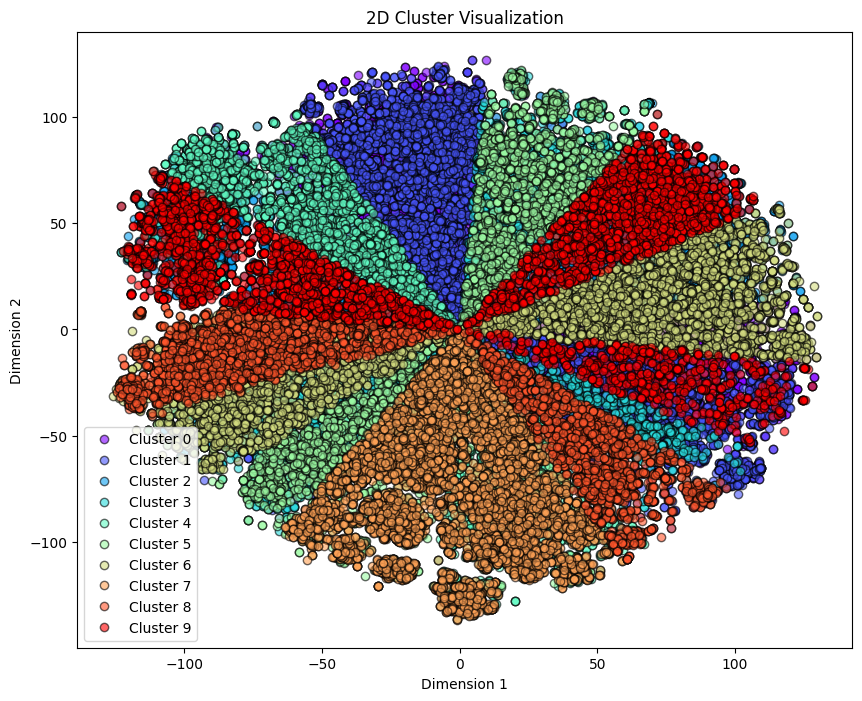

2024-06-18 15:37:04,955 - PreProcessingText - INFO - Extracting keywords from final clusters
2024-06-18 15:37:04,992 - PreProcessingText - INFO - 
Cluster 2, #8637 Elements


--------------------
[('miner', 0.235), ('togethor', 0.2307), ('tor', 0.2189), ('tom', 0.2163), ('daemon', 0.211)]


2024-06-18 15:43:29,716 - PreProcessingText - INFO - 
Cluster 0, #8446 Elements


[('daemon back', 0.3082), ('miner xmr', 0.2909), ('tom jerry', 0.2653), ('mralp back', 0.2586), ('mining dn', 0.2572)]
--------------------
--------------------
[('monero', 0.2242), ('moncler', 0.1937), ('miner', 0.1936), ('tor', 0.1832), ('tbigcoinmexicanbrokersmonerocardingstotedarknet', 0.1825)]


2024-06-18 15:50:35,632 - PreProcessingText - INFO - 
Cluster 8, #4807 Elements


[('node tor', 0.3219), ('tor node', 0.3174), ('monero mining', 0.2934), ('tor browser', 0.2896), ('newbie monero', 0.2868)]
--------------------
--------------------
[('hackerforhire', 0.2569), ('bitcard', 0.2005), ('hacker', 0.1945), ('cryptojacking', 0.1907), ('hacking', 0.1887)]


2024-06-18 15:54:15,769 - PreProcessingText - INFO - 
Cluster 5, #5490 Elements


[('hacker bitcard', 0.3535), ('hacking carding', 0.335), ('carding hacking', 0.333), ('carder hacker', 0.3321), ('passport hack', 0.3314)]
--------------------
--------------------
[('darkwebmarket', 0.4002), ('darknetmarketbusts', 0.3967), ('darknetmarkets', 0.3928), ('darknetmarketsoz', 0.3809), ('darknetmarketsnoobs', 0.3756)]


2024-06-18 16:00:03,961 - PreProcessingText - INFO - 
Cluster 3, #6780 Elements


[('banned darknetmarkets', 0.5537), ('market darkdotnetcom', 0.4657), ('darknet market', 0.4571), ('darkweb market', 0.4521), ('market darknet', 0.4489)]
--------------------
--------------------
[('methylnethylamphetamine', 0.2709), ('nethylnorpentedrone', 0.2694), ('lsdketaminemdma', 0.2686), ('nethylhexedrone', 0.268), ('napthylisopropylamine', 0.2611)]


2024-06-18 16:07:49,074 - PreProcessingText - INFO - 
Cluster 7, #6247 Elements


[('nethylnorpentedrone anybody', 0.3216), ('china oxycodone', 0.3122), ('pipelineuk amphetamine', 0.3104), ('asic antminer', 0.3007), ('fluorodeschloroketamine uk', 0.3001)]
--------------------
--------------------
[('bitcoinfrauder', 0.4347), ('bitcoinbillionaire', 0.4131), ('bitcoins', 0.3991), ('btcoin', 0.3916), ('localbitcoins', 0.3876)]


2024-06-18 16:13:17,000 - PreProcessingText - INFO - 
Cluster 1, #8001 Elements


[('monero bitcoin', 0.5326), ('bitcoin monero', 0.5292), ('mined bitcoins', 0.4941), ('scammer bitcoins', 0.4873), ('bitcoinfrauder account', 0.4799)]
--------------------
--------------------
[('cannabiskingz', 0.435), ('cannabisking', 0.4263), ('doctorcannabis', 0.426), ('cannabis', 0.4246), ('dmethamphetamine', 0.3932)]


2024-06-18 16:20:12,043 - PreProcessingText - INFO - 
Cluster 4, #6635 Elements


[('heroin cannabis', 0.5159), ('cannabis xtc', 0.5036), ('cryptonia cannabis', 0.5014), ('uk cannabis', 0.4959), ('cannabis weedmonopolet', 0.4913)]
--------------------
--------------------
[('cannabiskingz', 0.4264), ('cannabiskings', 0.4208), ('weedcocaine', 0.4197), ('cannabisnation', 0.4144), ('cannabiscup', 0.414)]


2024-06-18 16:25:39,921 - PreProcessingText - INFO - 
Cluster 9, #4798 Elements


[('selling cannabis', 0.5659), ('vending cannabis', 0.552), ('cannabis wholesale', 0.5487), ('wholesale cannabis', 0.546), ('cannabiskingz vendor', 0.5402)]
--------------------
--------------------
[('ukdrugdealer', 0.337), ('ukpharma', 0.3238), ('pharmabuds', 0.3123), ('dutchdrugz', 0.3081), ('wholesalebenzos', 0.2923)]


2024-06-18 16:29:41,905 - PreProcessingText - INFO - 
Cluster 6, #6894 Elements


[('finestflower vendor', 0.4296), ('selling opioids', 0.4281), ('sell opiate', 0.4158), ('selling flualprazolam', 0.4078), ('pharmaking selling', 0.4076)]
--------------------
--------------------
[('drugdealer', 0.3469), ('mdmadirtsharkresellers', 0.3261), ('venditore', 0.3031), ('vendedor', 0.2995), ('venditori', 0.2969)]
[('dream vendor', 0.4577), ('dealer dream', 0.4529), ('vendor dreamwsm', 0.4472), ('vendor dream', 0.4469), ('vendorshop dream', 0.4325)]
--------------------


In [8]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_clusters=10, n_words=10)
res.to_csv("Results_Cluster/distiluse_tSNE_agglomerative_10.csv", index=False)

### Agglomerative 20 cluster + tSNE + KeyBERT + Distiluse

2024-06-18 16:38:13,770 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [17:33<00:00,  1.01s/it]
2024-06-18 16:55:47,350 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-18 17:05:15,292 - PreProcessingText - INFO - Starting clustering with Agglomerative Clustering in batches


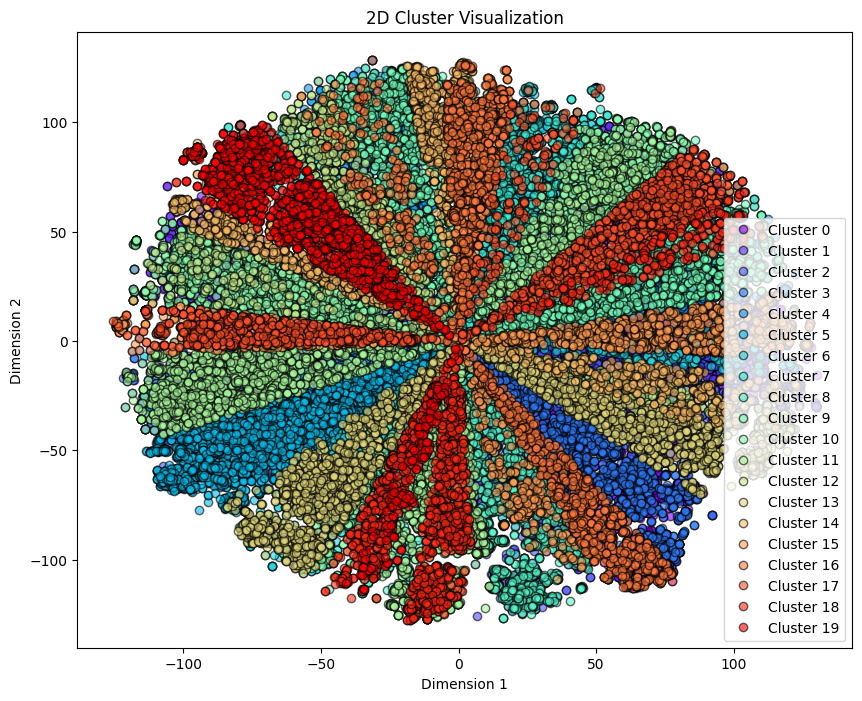

2024-06-18 17:08:56,105 - PreProcessingText - INFO - Extracting keywords from final clusters
2024-06-18 17:08:56,142 - PreProcessingText - INFO - 
Cluster 9, #3778 Elements


--------------------
[('tor', 0.2103), ('bartardzz', 0.1856), ('tbigcoinmexicanbrokersmonerocardingstotedarknet', 0.1843), ('happyshopperbulk', 0.1764), ('terryukstock', 0.1761)]


2024-06-18 17:12:31,306 - PreProcessingText - INFO - 
Cluster 0, #4710 Elements


[('bartardzz back', 0.2481), ('tor shrinked', 0.2388), ('tor running', 0.2342), ('suicidal back', 0.2324), ('tbigcoinmexicanbrokersmonerocardingstotedarknet scam', 0.2287)]
--------------------
--------------------
[('robocheckcm', 0.1864), ('unencrypted', 0.1837), ('robocheck', 0.1832), ('pqcrypto', 0.1822), ('decrypting', 0.1735)]


2024-06-18 17:16:18,657 - PreProcessingText - INFO - 
Cluster 12, #2815 Elements


[('node tor', 0.2922), ('tor node', 0.2895), ('monero crypto', 0.272), ('monero litecoin', 0.2684), ('undetectable monero', 0.2644)]
--------------------
--------------------
[('tor', 0.2439), ('saferollz', 0.2303), ('browser', 0.229), ('security', 0.2113), ('safety', 0.2066)]


2024-06-18 17:19:02,954 - PreProcessingText - INFO - 
Cluster 2, #3861 Elements


[('browser safest', 0.387), ('tor browser', 0.3856), ('tor security', 0.374), ('browser crosspost', 0.3372), ('site tor', 0.3233)]
--------------------
--------------------
[('bitcoinfrauder', 0.4145), ('bitcoinbillionaire', 0.3574), ('bitcoincomau', 0.3448), ('bitcoins', 0.342), ('localbitcoins', 0.3402)]


2024-06-18 17:22:11,729 - PreProcessingText - INFO - 
Cluster 8, #3238 Elements


[('bitcoinfrauder account', 0.4525), ('tracing bitcoins', 0.4497), ('bitcoin transactions', 0.4437), ('bitcoins transfer', 0.4402), ('bitcoin fake', 0.4378)]
--------------------
--------------------
[('darkwebmarket', 0.3463), ('darknetmarkets', 0.338), ('darknetmarketbusts', 0.335), ('darknetmarketsnoobs', 0.33), ('darknetmarketsoz', 0.3202)]


2024-06-18 17:25:22,039 - PreProcessingText - INFO - 
Cluster 3, #3905 Elements


[('banned darknetmarkets', 0.5302), ('scam darknetmarkets', 0.4907), ('scam darknetmarketsno', 0.4815), ('darknetcyberbunker scam', 0.4598), ('darkbay scam', 0.4531)]
--------------------
--------------------
[('hackerforhire', 0.3301), ('hacker', 0.3183), ('hacking', 0.2967), ('hack', 0.2928), ('hacket', 0.2805)]


2024-06-18 17:28:49,802 - PreProcessingText - INFO - 
Cluster 13, #3021 Elements


[('hacker bitcard', 0.4203), ('hacker service', 0.404), ('paysavecard hacking', 0.4037), ('carder hacker', 0.3984), ('hacker carder', 0.3958)]
--------------------
--------------------
[('dreammarket', 0.3945), ('nightmaremarket', 0.3853), ('nighmaremarket', 0.2965), ('darkmarket', 0.2954), ('marketer', 0.2922)]


2024-06-18 17:31:37,324 - PreProcessingText - INFO - 
Cluster 6, #3717 Elements


[('chemist dreammarket', 0.4665), ('dreammarket scammed', 0.457), ('marketplace dream', 0.4563), ('dreammarket anyone', 0.4563), ('market dream', 0.4552)]
--------------------
--------------------
[('methylnethylamphetamine', 0.2285), ('nethylhexedrone', 0.2207), ('nethylnorpentedrone', 0.2175), ('ethylhexedrone', 0.2075), ('greenmountainman', 0.2067)]


2024-06-18 17:35:11,840 - PreProcessingText - INFO - 
Cluster 17, #2318 Elements


[('nethylhexedrone domestic', 0.2797), ('asic antminer', 0.2701), ('america methylnethylamphetamine', 0.2696), ('iamlilxan greenbeansusa', 0.2621), ('nethylnorpentedrone anybody', 0.2606)]
--------------------
--------------------
[('mining', 0.2784), ('freeweeduk', 0.2327), ('md', 0.2312), ('nmm', 0.2292), ('freebie', 0.229)]


2024-06-18 17:37:18,596 - PreProcessingText - INFO - 
Cluster 16, #2630 Elements


[('mining dn', 0.3502), ('md free', 0.3405), ('real mining', 0.3346), ('free electricity', 0.3152), ('mdma free', 0.3084)]
--------------------
--------------------
[('bitcoin', 0.31), ('btcoin', 0.3098), ('gocashgamecard', 0.2817), ('monero', 0.2766), ('miner', 0.2753)]


2024-06-18 17:40:24,101 - PreProcessingText - INFO - 
Cluster 5, #3829 Elements


[('monero bitcoin', 0.5059), ('bitcoin monero', 0.4929), ('monero wallet', 0.4154), ('monero wallets', 0.4133), ('cashing monero', 0.3982)]
--------------------
--------------------
[('wholesale', 0.2853), ('vend', 0.2834), ('vendot', 0.2831), ('selling', 0.2794), ('verkaufen', 0.2763)]


2024-06-18 17:45:10,583 - PreProcessingText - INFO - 
Cluster 14, #3565 Elements


[('selling uk', 0.4129), ('uk vendor', 0.4037), ('uk vendors', 0.4027), ('vendor uk', 0.4026), ('vendors uk', 0.3994)]
--------------------
--------------------
[('cannabisagent', 0.4111), ('dmethamphetamine', 0.401), ('ukstudydrugs', 0.389), ('cannabiskingz', 0.3813), ('cocainepharmacy', 0.3763)]


2024-06-18 17:50:21,243 - PreProcessingText - INFO - 
Cluster 7, #2455 Elements


[('methamphetamine vaping', 0.5109), ('weed drugsdownunder', 0.4747), ('medicinal cannabis', 0.471), ('pill cannabiskingz', 0.4639), ('heroin weed', 0.4635)]
--------------------
--------------------
[('cocainehcl', 0.4289), ('cocaineunlimited', 0.4022), ('cocaine', 0.3984), ('coca', 0.3899), ('cocainecowboys', 0.3892)]


2024-06-18 17:53:19,222 - PreProcessingText - INFO - 
Cluster 1, #4335 Elements


[('cocaine tested', 0.5107), ('coke narco', 0.5023), ('tested cocaine', 0.5018), ('heroin coke', 0.4974), ('cocacolacompany heroin', 0.4966)]
--------------------
--------------------
[('cannabisozkings', 0.4245), ('cannabiskingz', 0.4201), ('cannabiskings', 0.4188), ('cannabisking', 0.4178), ('cannabis', 0.4093)]


2024-06-18 17:57:32,001 - PreProcessingText - INFO - 
Cluster 15, #2088 Elements


[('cannabis vender', 0.5533), ('selling cannabis', 0.5516), ('cannabis wholesale', 0.5494), ('uk cannabisking', 0.5471), ('uk cannabis', 0.5431)]
--------------------
--------------------
[('ukweedshop', 0.2755), ('ukweedstore', 0.2636), ('finestflower', 0.2629), ('wholesale', 0.2536), ('uk', 0.2331)]


2024-06-18 17:59:31,850 - PreProcessingText - INFO - 
Cluster 10, #3715 Elements


[('uk selling', 0.383), ('sale uk', 0.3778), ('sale britishknights', 0.3771), ('flower vendor', 0.3765), ('sale flower', 0.3725)]
--------------------
--------------------
[('dutchdopecrew', 0.2519), ('dutchbulk', 0.2517), ('dutchkingdom', 0.2427), ('dutchw', 0.2396), ('amsterdam', 0.2366)]


2024-06-18 18:03:27,010 - PreProcessingText - INFO - 
Cluster 11, #3803 Elements


[('dutchbulk looking', 0.3752), ('dutchpastor looking', 0.36), ('dutchdopecrew looking', 0.3577), ('mdma looking', 0.3431), ('looking mr', 0.3423)]
--------------------
--------------------
[('mdmadirtsharkresellers', 0.361), ('venditore', 0.2801), ('wholesaler', 0.277), ('wholesaleraus', 0.2758), ('venditori', 0.2746)]


2024-06-18 18:07:38,321 - PreProcessingText - INFO - 
Cluster 4, #4464 Elements


[('md vendor', 0.4113), ('mdma vendor', 0.4085), ('mdma vendors', 0.4069), ('vendor md', 0.4057), ('vendor uk', 0.4024)]
--------------------
--------------------
[('prescriptiondrug', 0.4831), ('prescriptiondrugs', 0.4829), ('pharmaceutical', 0.4651), ('pharmacylabsonly', 0.4647), ('pharmacautical', 0.4643)]


2024-06-18 18:11:58,133 - PreProcessingText - INFO - 
Cluster 19, #2423 Elements


[('drugs croatia', 0.5385), ('pharma xanax', 0.5262), ('pills pharmafox', 0.5231), ('xanax pharmacy', 0.5217), ('xanaxdaddy pillsexpress', 0.5163)]
--------------------
--------------------
[('coke', 0.3956), ('cokecity', 0.3926), ('cocainehcl', 0.3891), ('cocaineinc', 0.3887), ('cocainepurity', 0.384)]


2024-06-18 18:15:34,773 - PreProcessingText - INFO - 
Cluster 18, #2065 Elements


[('coke reliable', 0.5495), ('reliable coke', 0.5352), ('coke dealer', 0.5234), ('coke vendors', 0.5216), ('coke vendor', 0.5186)]
--------------------
--------------------
[('empire', 0.3085), ('empires', 0.3042), ('weaverofdreams', 0.282), ('empiremoderator', 0.2771), ('dream', 0.2696)]
[('dream empire', 0.4846), ('empire dream', 0.483), ('empire nightmare', 0.4755), ('weaverofdreams empire', 0.4734), ('nightmare empire', 0.4669)]
--------------------


In [10]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_clusters=20, n_words=10)
res.to_csv("Results_Cluster/distiluse_tSNE_agglomerative_20.csv", index=False)

### Agglomerative 15 cluster + tSNE + KeyBERT + Distiluse

2024-06-18 18:18:11,585 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [19:58<00:00,  1.15s/it] 
2024-06-18 18:38:10,443 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-18 18:49:57,647 - PreProcessingText - INFO - Starting clustering with Agglomerative Clustering in batches


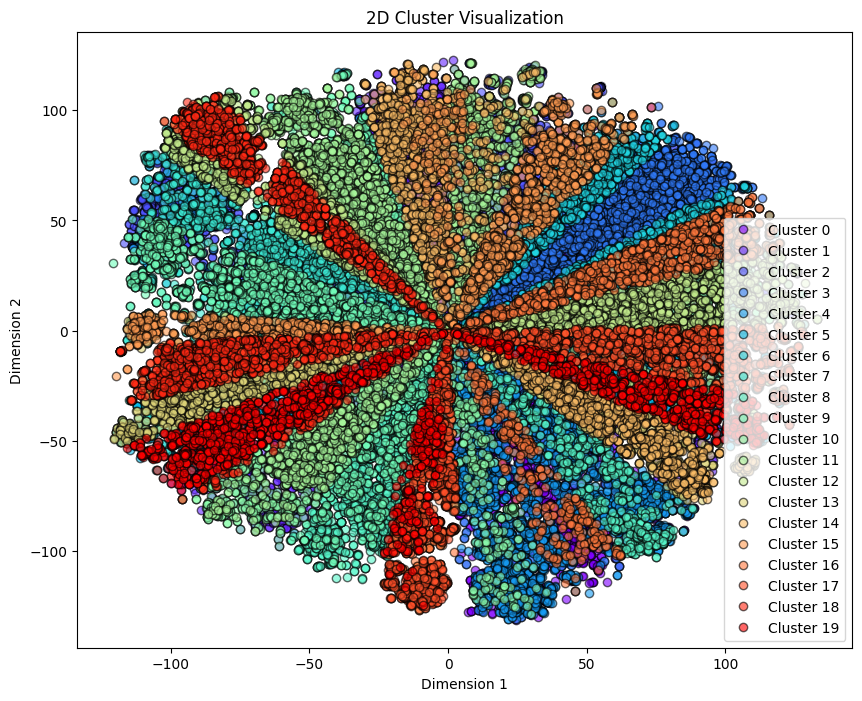

2024-06-18 19:06:12,782 - PreProcessingText - INFO - Extracting keywords from final clusters
2024-06-18 19:06:12,814 - PreProcessingText - INFO - 
Cluster 12, #4150 Elements


--------------------
[('tor', 0.2123), ('soccer', 0.1938), ('recover', 0.1766), ('football', 0.1713), ('missamerica', 0.1635)]


2024-06-18 19:09:49,318 - PreProcessingText - INFO - 
Cluster 5, #4000 Elements


[('tor search', 0.2716), ('dutchdrugz back', 0.2579), ('tor shrinked', 0.2527), ('tor browser', 0.2508), ('tor tor', 0.2466)]
--------------------
--------------------
[('tor', 0.2213), ('monero', 0.2193), ('miner', 0.2085), ('raiddeepdotweb', 0.2046), ('robocheckcm', 0.1862)]


2024-06-18 19:13:07,420 - PreProcessingText - INFO - 
Cluster 0, #4806 Elements


[('tor node', 0.3254), ('monero mining', 0.2982), ('monero safe', 0.2854), ('mybreakdownflow monero', 0.2853), ('updated tor', 0.285)]
--------------------
--------------------
[('bitcoinfrauder', 0.4518), ('bitcoinbillionaire', 0.4043), ('bitcoins', 0.3957), ('bitcoincomau', 0.3906), ('bitcoinsuperbuycom', 0.3873)]


2024-06-18 19:17:34,899 - PreProcessingText - INFO - 
Cluster 10, #2802 Elements


[('mined bitcoins', 0.5147), ('bitcoin miner', 0.5092), ('bitcoin monero', 0.5085), ('monero bitcoin', 0.505), ('bitcoin mining', 0.5041)]
--------------------
--------------------
[('darknetmarketbusts', 0.4537), ('darknetmarkets', 0.4486), ('darkwebmarket', 0.4349), ('darknetmarketsoz', 0.4294), ('darknetmarketsnoobs', 0.4289)]


2024-06-18 19:20:22,583 - PreProcessingText - INFO - 
Cluster 14, #2465 Elements


[('banned darknetmarkets', 0.5984), ('nightmaremarket banned', 0.5118), ('darknet market', 0.5105), ('darknet marketplaces', 0.4885), ('darknet markets', 0.4881)]
--------------------
--------------------
[('hackerforhire', 0.2922), ('hacker', 0.2778), ('darkweb', 0.2715), ('hackers', 0.2674), ('darklab', 0.2471)]


2024-06-18 19:23:04,061 - PreProcessingText - INFO - 
Cluster 19, #2159 Elements


[('hacker darkweb', 0.4189), ('services hacker', 0.3685), ('hacker service', 0.367), ('service darklab', 0.3569), ('hackerforhire job', 0.3498)]
--------------------
--------------------
[('market', 0.2731), ('marketplace', 0.2689), ('markets', 0.2635), ('dreammarket', 0.2606), ('marketing', 0.2464)]


2024-06-18 19:25:07,247 - PreProcessingText - INFO - 
Cluster 6, #2809 Elements


[('libertas market', 0.3852), ('liberty market', 0.3787), ('marketplace megathread', 0.3692), ('lsd market', 0.3659), ('connectingbrit market', 0.3597)]
--------------------
--------------------
[('dutchdrugz', 0.2596), ('greenmountainman', 0.2575), ('china', 0.2383), ('chinese', 0.2292), ('amsterdambulk', 0.223)]


2024-06-18 19:27:29,673 - PreProcessingText - INFO - 
Cluster 16, #2852 Elements


[('greenmountainman chinese', 0.3791), ('antminer dutchbulk', 0.3498), ('china etizalam', 0.3381), ('weed dutchdrugz', 0.3355), ('uk cannabis', 0.3221)]
--------------------
--------------------
[('mining', 0.252), ('bitcoinlaundry', 0.2431), ('bitcoinlaundering', 0.2374), ('electricity', 0.2235), ('bitcoin', 0.2088)]


2024-06-18 19:29:50,593 - PreProcessingText - INFO - 
Cluster 3, #3972 Elements


[('real mining', 0.3263), ('mining welcome', 0.3219), ('free electricity', 0.3115), ('electricity real', 0.3055), ('ran bitcoinlaundering', 0.2841)]
--------------------
--------------------
[('dds', 0.2244), ('dd', 0.2206), ('dm', 0.2121), ('daemon', 0.2087), ('dnl', 0.2075)]


2024-06-18 19:33:00,136 - PreProcessingText - INFO - 
Cluster 4, #4353 Elements


[('looking lsd', 0.3413), ('lsd looking', 0.3358), ('lsd happy', 0.3099), ('ddos looking', 0.3085), ('dl looking', 0.3053)]
--------------------
--------------------
[('ddchecksbank', 0.32), ('bitcoinlaundering', 0.3113), ('gocashgamecard', 0.3078), ('creditcard', 0.3053), ('ukfraud', 0.2844)]


2024-06-18 19:36:50,473 - PreProcessingText - INFO - 
Cluster 11, #3532 Elements


[('bitcoin carding', 0.4161), ('carding bitcoins', 0.4146), ('card counterfeit', 0.3849), ('simcard bank', 0.3807), ('counterfeit carding', 0.3806)]
--------------------
--------------------
[('cannabiskingz', 0.4175), ('cannabisking', 0.4101), ('cannabiskings', 0.4068), ('cannabis', 0.4042), ('marijuana', 0.3725)]


2024-06-18 19:40:12,335 - PreProcessingText - INFO - 
Cluster 7, #3056 Elements


[('cocaine cannabis', 0.5491), ('coke cannabiskingz', 0.5248), ('weed cocain', 0.5198), ('weed cocaine', 0.516), ('cocaine weed', 0.5135)]
--------------------
--------------------
[('cannabisagent', 0.4005), ('doctorcannabis', 0.3895), ('cannabiselite', 0.3872), ('cannabiskings', 0.3828), ('cannabis', 0.3815)]


2024-06-18 19:43:15,864 - PreProcessingText - INFO - 
Cluster 1, #4629 Elements


[('selling cannabis', 0.5459), ('wholesale cannabis', 0.5343), ('cannabis sale', 0.5305), ('vending cannabis', 0.5244), ('sale cannabis', 0.5226)]
--------------------
--------------------
[('dmethamphetamine', 0.3624), ('canadianpharmacy', 0.3411), ('methamphetamine', 0.3352), ('roxycodone', 0.3342), ('dextroamphetamine', 0.328)]


2024-06-18 19:48:16,112 - PreProcessingText - INFO - 
Cluster 2, #4861 Elements


[('best ketamine', 0.429), ('vapes ketaminekings', 0.427), ('best drugs', 0.4225), ('valium ketamine', 0.4216), ('best meth', 0.4142)]
--------------------
--------------------
[('lloydspharmacy', 0.3422), ('dutchdrugs', 0.3419), ('phenylacetamide', 0.338), ('pharmafunk', 0.3324), ('ukstudydrugs', 0.332)]


2024-06-18 19:52:47,311 - PreProcessingText - INFO - 
Cluster 15, #2339 Elements


[('dutchdrugs psychedelium', 0.404), ('ordered lloydspharmacy', 0.3933), ('fluorodeschloroketamine uk', 0.3884), ('lloydspharmacy anyone', 0.3703), ('weed dutchdrugz', 0.3671)]
--------------------
--------------------
[('ukdrugdealer', 0.3558), ('pharmamaster', 0.3), ('narcoticsanonymousau', 0.2993), ('dutchdrugz', 0.2979), ('drugpharmacist', 0.2962)]


2024-06-18 19:55:00,642 - PreProcessingText - INFO - 
Cluster 18, #2466 Elements


[('vendor narcoticsanonymousau', 0.4429), ('narcotic vendor', 0.44), ('vendor narcotics', 0.4397), ('vendor narcotic', 0.4327), ('dream vendor', 0.4296)]
--------------------
--------------------
[('cokeboys', 0.3757), ('coke', 0.3508), ('weedcocaine', 0.3394), ('coca', 0.312), ('ukdrugdealer', 0.3082)]


2024-06-18 19:57:36,981 - PreProcessingText - INFO - 
Cluster 9, #3144 Elements


[('uk coke', 0.493), ('weed coke', 0.4811), ('coke dealer', 0.4726), ('coke weed', 0.4703), ('coke reseller', 0.4662)]
--------------------
--------------------
[('pharmabay', 0.4019), ('drugsmakeusmarter', 0.3966), ('cocainepharmacy', 0.395), ('pharmaking', 0.3925), ('pharmak', 0.3913)]


2024-06-18 20:01:02,371 - PreProcessingText - INFO - 
Cluster 13, #2716 Elements


[('methamphetamine vendor', 0.4835), ('pharmaking selling', 0.4813), ('pharmacy selling', 0.4804), ('vendor pharmaceutical', 0.4708), ('selling opioids', 0.4667)]
--------------------
--------------------
[('vendedor', 0.3626), ('mdmadirtsharkresellers', 0.3572), ('vendorshop', 0.3447), ('vendors', 0.3427), ('vendor', 0.3425)]


2024-06-18 20:03:29,074 - PreProcessingText - INFO - 
Cluster 8, #3065 Elements


[('trustworthy vendor', 0.4942), ('reliable vendor', 0.4909), ('vendor reliable', 0.4898), ('vendor trust', 0.4782), ('trustable seller', 0.4727)]
--------------------
--------------------
[('dreams', 0.2828), ('dreammarket', 0.2812), ('dream', 0.2806), ('weaverofdreams', 0.2689), ('buythemgcom', 0.2668)]


2024-06-18 20:06:46,921 - PreProcessingText - INFO - 
Cluster 17, #2559 Elements


[('dream scammer', 0.4421), ('scammer dream', 0.4363), ('dream scamming', 0.4335), ('dream scam', 0.4193), ('scammed dream', 0.4186)]
--------------------
--------------------
[('empiremktxgjovhmonion', 0.3106), ('empire', 0.2933), ('imperialroyalty', 0.2746), ('darkestnightmare', 0.216), ('concert', 0.186)]
[('darkestnightmare empire', 0.4279), ('empire nightmare', 0.4058), ('empire fuck', 0.3983), ('nightmare empire', 0.3972), ('vladdyrsag empire', 0.3957)]
--------------------


In [11]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_clusters=20, n_words=10)
res.to_csv("Results_Cluster/distiluse_tSNE_agglomerative_15.csv", index=False)

### KMeans 3 cluster + tSNE + KeyBERT + Distiluse

2024-06-20 03:19:25,999 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [18:36<00:00,  1.07s/it]
2024-06-20 03:38:03,421 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-20 03:47:13,303 - PreProcessingText - INFO - Starting clustering with MiniBatch K-Means Clustering


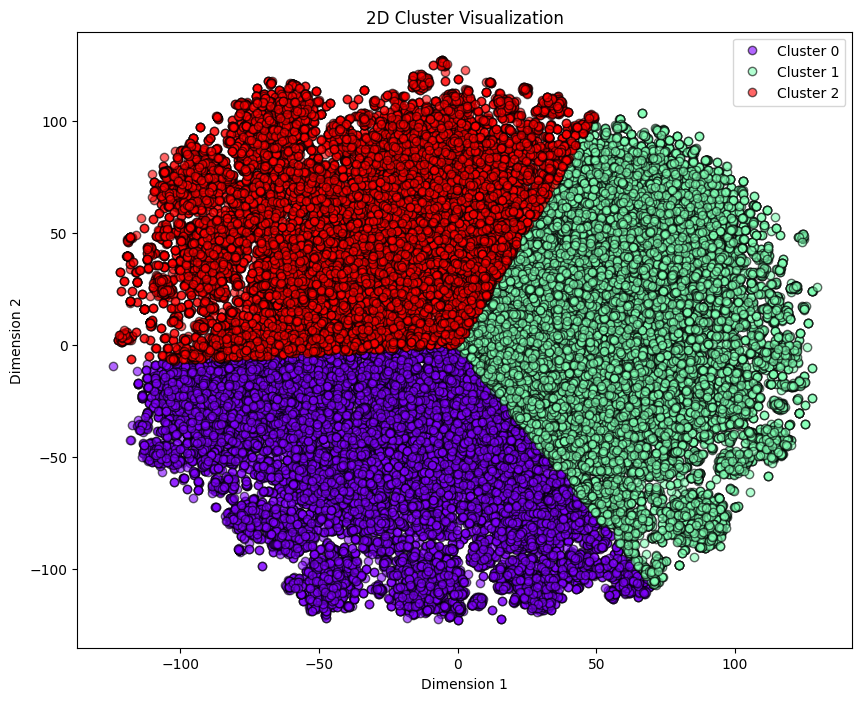

2024-06-20 03:47:16,157 - PreProcessingText - INFO - Evaluating Silhouette Score
2024-06-20 03:48:28,456 - PreProcessingText - INFO - Silhouette Score: 0.48680269718170166
2024-06-20 03:48:28,456 - PreProcessingText - INFO - Evaluating Davies-Bouldin Index
2024-06-20 03:48:28,456 - PreProcessingText - INFO - Davies-Bouldin Index: 0.7153026714732594
2024-06-20 03:48:28,456 - PreProcessingText - INFO - Extracting keywords from final clusters
Processing clusters:   0%|          | 0/3 [00:00<?, ?it/s]2024-06-20 03:48:36,224 - PreProcessingText - INFO - 
Cluster 1, #22692 Elements
2024-06-20 03:48:36,246 - PreProcessingText - INFO - Extracting top 5 keywords from cluster
2024-06-20 03:49:53,125 - PreProcessingText - INFO - 1-gram topics: [('torbrowser', 0.3341), ('tor', 0.3094), ('torrc', 0.3011), ('torpremier', 0.2939), ('torum', 0.2883)]
2024-06-20 03:59:47,492 - PreProcessingText - INFO - 1-2-gram topics: [('tor browser', 0.4365), ('tor error', 0.4087), ('tor bug', 0.4073), ('tor torstre

In [3]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_clusters=3, n_words=30, k_means=True)
res.to_csv("Results_Cluster/distiluse_tSNE_kmeans_3_window30.csv", index=False)

### KMeans 5 cluster + tSNE + KeyBERT + Distiluse

2024-06-20 04:25:02,541 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [15:56<00:00,  1.09it/s]
2024-06-20 04:40:59,706 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-20 04:49:58,827 - PreProcessingText - INFO - Starting clustering with MiniBatch K-Means Clustering


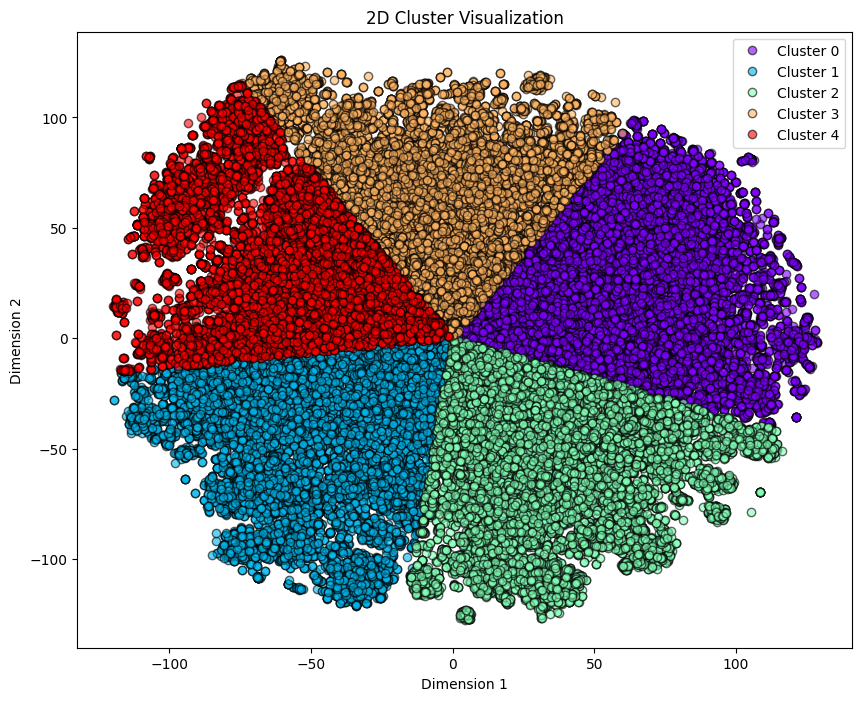

2024-06-20 04:49:59,574 - PreProcessingText - INFO - Evaluating Silhouette Score
2024-06-20 04:51:10,489 - PreProcessingText - INFO - Silhouette Score: 0.49684250354766846
2024-06-20 04:51:10,489 - PreProcessingText - INFO - Evaluating Davies-Bouldin Index
2024-06-20 04:51:10,497 - PreProcessingText - INFO - Davies-Bouldin Index: 0.5954751954466382
2024-06-20 04:51:10,497 - PreProcessingText - INFO - Extracting keywords from final clusters
Processing clusters:   0%|          | 0/5 [00:00<?, ?it/s]2024-06-20 04:51:17,783 - PreProcessingText - INFO - 
Cluster 0, #14462 Elements
2024-06-20 04:51:17,799 - PreProcessingText - INFO - Extracting top 5 keywords from cluster
2024-06-20 04:52:14,812 - PreProcessingText - INFO - 1-gram topics: [('torum', 0.2984), ('tor', 0.2935), ('togethor', 0.285), ('torpremier', 0.2468), ('miner', 0.2425)]
2024-06-20 04:58:23,472 - PreProcessingText - INFO - 1-2-gram topics: [('tor node', 0.3943), ('node tor', 0.3829), ('tor web', 0.3695), ('site tor', 0.3678)

In [4]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_clusters=5, n_words=30, k_means=True)
res.to_csv("Results_Cluster/distiluse_tSNE_kmeans_5_window30.csv", index=False)

### KMeans 6 cluster + tSNE + KeyBERT + Distiluse

2024-06-20 09:41:06,415 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [18:08<00:00,  1.04s/it] 
2024-06-20 09:59:16,191 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-20 10:10:14,653 - PreProcessingText - INFO - Starting clustering with MiniBatch K-Means Clustering
2024-06-20 10:10:15,429 - PreProcessingText - INFO - Plotting the Elbow Method for K-Means
Evaluating K-Means Clustering: 100%|██████████| 25/25 [00:13<00:00,  1.80it/s]


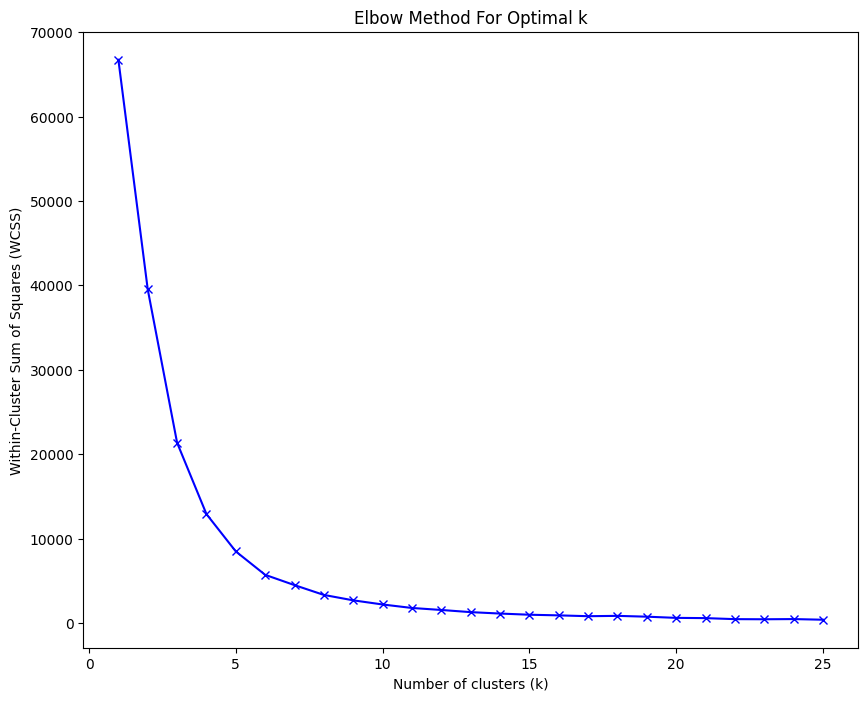

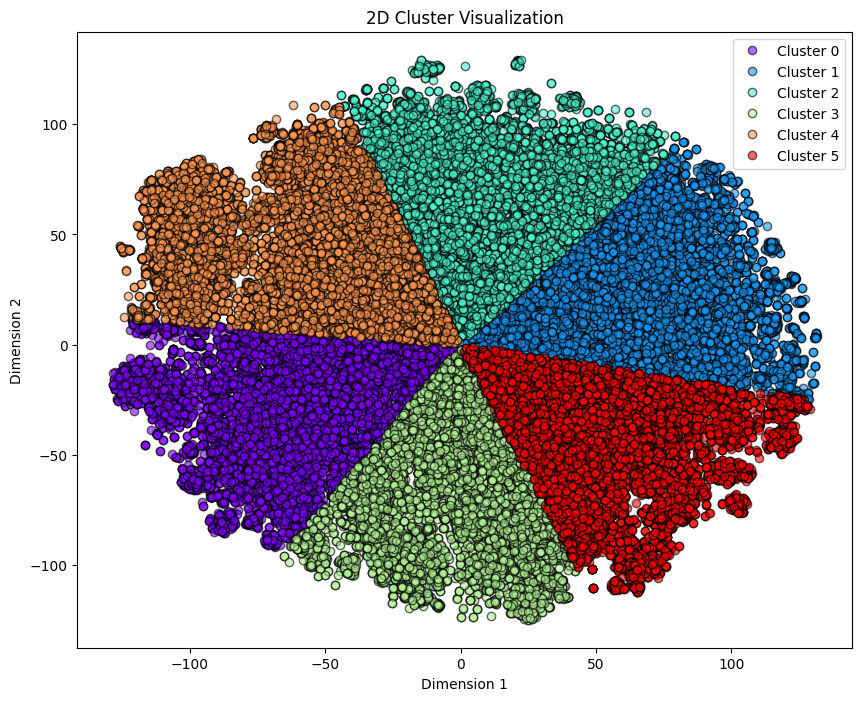

2024-06-20 10:10:31,766 - PreProcessingText - INFO - Evaluating Silhouette Score
2024-06-20 10:11:49,986 - PreProcessingText - INFO - Silhouette Score: 0.5068698525428772
2024-06-20 10:11:49,987 - PreProcessingText - INFO - Evaluating Davies-Bouldin Index
2024-06-20 10:11:50,001 - PreProcessingText - INFO - Davies-Bouldin Index: 0.5593130117015201
2024-06-20 10:11:50,001 - PreProcessingText - INFO - Extracting keywords from final clusters
Processing clusters:   0%|          | 0/6 [00:00<?, ?it/s]2024-06-20 10:12:10,956 - PreProcessingText - INFO - 
Cluster 1, #11236 Elements
2024-06-20 10:12:10,971 - PreProcessingText - INFO - Extracting top 5 keywords from cluster
2024-06-20 10:13:06,167 - PreProcessingText - INFO - 1-gram topics: [('greenmountainman', 0.2591), ('tor', 0.2553), ('togethor', 0.2436), ('daemon', 0.2417), ('mining', 0.2389)]
2024-06-20 10:20:26,242 - PreProcessingText - INFO - 1-2-gram topics: [('daemon wiki', 0.3268), ('dns tor', 0.3067), ('tor browser', 0.3064), ('linu

In [4]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_clusters=6, n_words=30, k_means=True, elbow=True)
res.to_csv("Results_Cluster/distiluse_tSNE_kmeans_6_window30.csv", index=False)

### KMeans 7 cluster + tSNE + KeyBERT + Distiluse

2024-06-20 17:36:56,311 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [23:44<00:00,  1.37s/it]
2024-06-20 18:00:41,733 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-20 18:10:58,047 - PreProcessingText - INFO - Starting clustering with MiniBatch K-Means Clustering


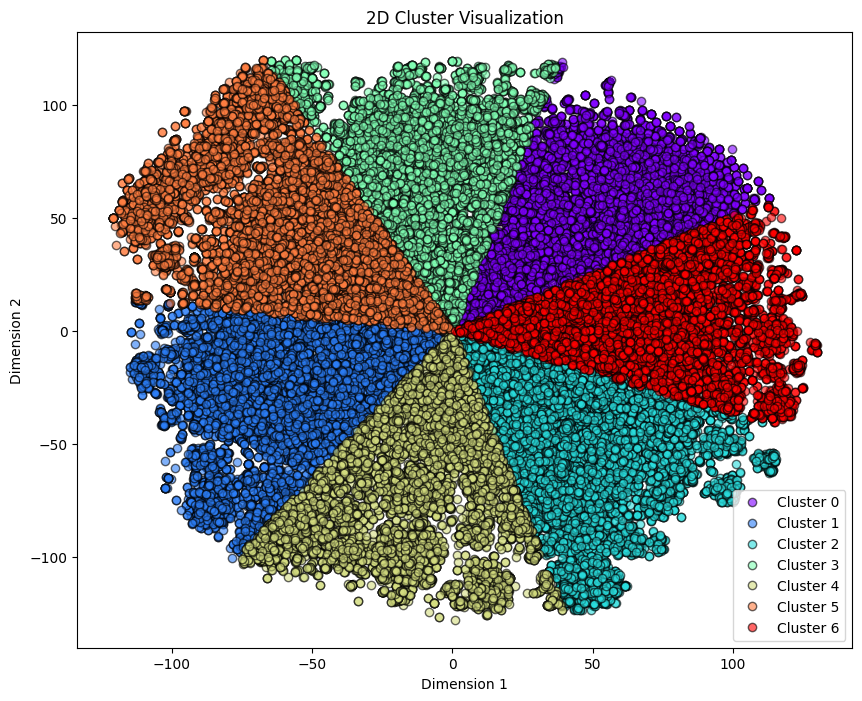

2024-06-20 18:11:03,923 - PreProcessingText - INFO - Evaluating Silhouette Score
2024-06-20 18:12:20,242 - PreProcessingText - INFO - Silhouette Score: 0.5078768134117126
2024-06-20 18:12:20,242 - PreProcessingText - INFO - Evaluating Davies-Bouldin Index
2024-06-20 18:12:20,270 - PreProcessingText - INFO - Davies-Bouldin Index: 0.5562300226715886
2024-06-20 18:12:20,270 - PreProcessingText - INFO - Extracting keywords from final clusters
Processing clusters:   0%|          | 0/7 [00:00<?, ?it/s]2024-06-20 18:12:29,970 - PreProcessingText - INFO - 
Cluster 6, #8787 Elements
2024-06-20 18:12:29,999 - PreProcessingText - INFO - Extracting top 5 keywords from cluster
2024-06-20 18:13:18,520 - PreProcessingText - INFO - 1-gram topics: [('tor', 0.2703), ('turkey', 0.2009), ('troll', 0.195), ('trting', 0.1896), ('shitpost', 0.1862)]
2024-06-20 18:18:10,650 - PreProcessingText - INFO - 1-2-gram topics: [('tor node', 0.3159), ('ran tor', 0.3106), ('tor error', 0.3024), ('tor shrinked', 0.2991)

In [6]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_clusters=7, n_words=30, k_means=True)
res.to_csv("Results_Cluster/distiluse_tSNE_kmeans_7_window30.csv", index=False)

### KMeans 10 cluster + tSNE + KeyBERT + Distiluse

2024-06-18 20:22:45,459 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [17:15<00:00,  1.01it/s]
2024-06-18 20:40:01,721 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-18 20:49:44,133 - PreProcessingText - INFO - Starting clustering with MiniBatchAgglomerativeClustering


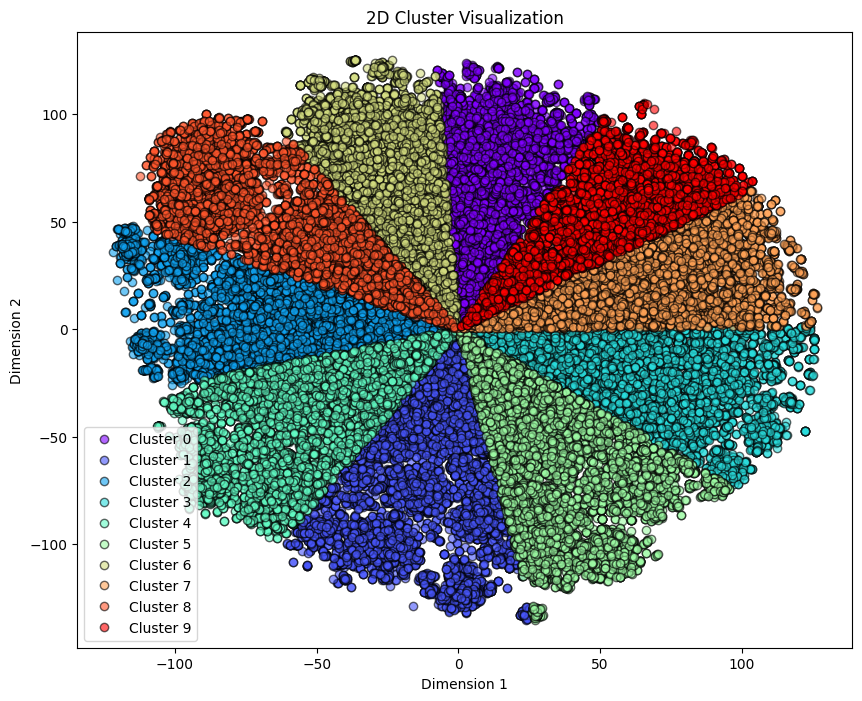

2024-06-18 20:49:46,904 - PreProcessingText - INFO - Extracting keywords from final clusters
2024-06-18 20:49:46,904 - PreProcessingText - INFO - 
Cluster 7, #6075 Elements


--------------------
[('mining', 0.2412), ('electricity', 0.2076), ('shitpost', 0.2009), ('tcp', 0.1966), ('tmg', 0.1965)]


2024-06-18 20:53:57,192 - PreProcessingText - INFO - 
Cluster 3, #6717 Elements


[('mining back', 0.3066), ('shitpost hello', 0.2792), ('real mining', 0.2764), ('welcome cryptomining', 0.2654), ('cryptomining welcome', 0.2608)]
--------------------
--------------------
[('torum', 0.2179), ('tor', 0.2165), ('miner', 0.1996), ('monereo', 0.1952), ('monerowalletgui', 0.1897)]


2024-06-18 20:58:19,148 - PreProcessingText - INFO - 
Cluster 5, #8310 Elements


[('tor ios', 0.3077), ('tor node', 0.307), ('tor running', 0.2927), ('monero node', 0.2886), ('tumbler monero', 0.2828)]
--------------------
--------------------
[('torbrowser', 0.2588), ('hackerforhire', 0.2522), ('btcoin', 0.2385), ('bitcoins', 0.2346), ('bitcoin', 0.2333)]


2024-06-18 21:04:28,539 - PreProcessingText - INFO - 
Cluster 1, #8163 Elements


[('tor browser', 0.3865), ('browser miner', 0.3737), ('browser crosspost', 0.3543), ('bitcoins monero', 0.3473), ('crypto browser', 0.3466)]
--------------------
--------------------
[('bitcoinlaundering', 0.3825), ('bitcoinfrauder', 0.3778), ('bitcoinlabelsinfo', 0.3398), ('darknetmarkets', 0.3192), ('darknetmarketnoobs', 0.319)]


2024-06-18 21:11:25,849 - PreProcessingText - INFO - 
Cluster 4, #7299 Elements


[('banned bitcoinsuperbuycom', 0.4891), ('darknetmarkets banned', 0.4871), ('banned darknetmarkets', 0.4841), ('darknetmarkets ban', 0.4841), ('darknetmarketsnoobs banned', 0.473)]
--------------------
--------------------
[('dreammarket', 0.3357), ('nightmaremarkets', 0.3311), ('nightmaremarket', 0.3274), ('dreamarket', 0.2945), ('scammarket', 0.2923)]


2024-06-18 21:17:16,820 - PreProcessingText - INFO - 
Cluster 9, #5534 Elements


[('dreammarket scammed', 0.423), ('dream darknetmarkets', 0.4121), ('legit dreammarket', 0.4078), ('dreammarket vendors', 0.4074), ('vendor dreammarket', 0.4029)]
--------------------
--------------------
[('dutchdrugrally', 0.3007), ('dutchmagic', 0.3006), ('dutchhq', 0.2989), ('dutchmasteruk', 0.295), ('dutchmastersuk', 0.2899)]


2024-06-18 21:21:12,546 - PreProcessingText - INFO - 
Cluster 6, #5989 Elements


[('antminer dutchbulk', 0.392), ('mdma dutch', 0.3654), ('dutchmastersuk lsd', 0.3597), ('dmukdcuk dutchmastersuk', 0.3584), ('dutch mdma', 0.3578)]
--------------------
--------------------
[('kidcannabis', 0.435), ('cannabiscup', 0.4305), ('cannabisinduced', 0.4248), ('cannabisinfused', 0.4222), ('cannabiskingz', 0.412)]


2024-06-18 21:26:36,503 - PreProcessingText - INFO - 
Cluster 8, #6867 Elements


[('uk cannabis', 0.5172), ('coke cannabiskingz', 0.5041), ('cocaine cannabis', 0.5026), ('cannabis honestcocaine', 0.5014), ('weed cannabiscup', 0.4976)]
--------------------
--------------------
[('cannabissexpress', 0.4183), ('doctorcannabis', 0.3952), ('cannabisagent', 0.3945), ('cannabiselite', 0.3839), ('cannabisozkings', 0.3826)]


2024-06-18 21:32:21,266 - PreProcessingText - INFO - 
Cluster 0, #5246 Elements


[('selling cannabis', 0.5528), ('cannabis sales', 0.5358), ('wholesale cannabis', 0.5342), ('cannabis sale', 0.534), ('sale cannabis', 0.5324)]
--------------------
--------------------
[('pharmapillsnowoncore', 0.398), ('drugpharmacy', 0.3864), ('pharmacyofdrugs', 0.3809), ('drugpharmacist', 0.3804), ('canadapharmacy', 0.3773)]


2024-06-18 21:36:49,930 - PreProcessingText - INFO - 
Cluster 2, #6535 Elements


[('noshow drugpharmacist', 0.4416), ('pharmahuasca chucknorristeam', 0.4396), ('drugs croatia', 0.4342), ('cannazon drugsuk', 0.4337), ('drugs uk', 0.4301)]
--------------------
--------------------
[('mdmadirtsharkresellers', 0.3649), ('vendorbbmc', 0.3104), ('ukweedstore', 0.2977), ('ukweedshop', 0.2885), ('wholesaler', 0.2854)]
[('dutchxmdma vendor', 0.4376), ('vendor uk', 0.4308), ('uk vendor', 0.4296), ('ukforgery vendor', 0.4288), ('uk reseller', 0.4268)]
--------------------


In [4]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_clusters=10, n_words=30, k_means=True)
res.to_csv("Results_Cluster/distiluse_tSNE_kmeans_10_window30.csv", index=False)

### KMeans 15 cluster + tSNE + KeyBERT + Distiluse

2024-06-18 22:05:23,787 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [19:36<00:00,  1.13s/it]
2024-06-18 22:25:00,936 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-18 22:33:52,721 - PreProcessingText - INFO - Starting clustering with MiniBatchAgglomerativeClustering


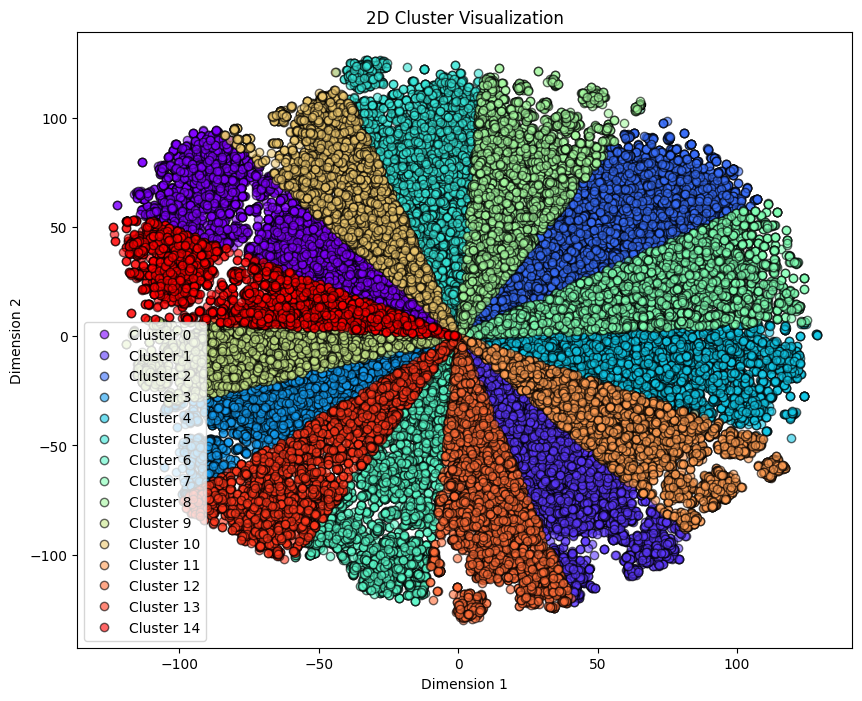

2024-06-18 22:33:56,913 - PreProcessingText - INFO - Extracting keywords from final clusters
2024-06-18 22:33:56,913 - PreProcessingText - INFO - 
Cluster 2, #5488 Elements


--------------------
[('dutchdrugrally', 0.3128), ('dutchdopecrew', 0.3101), ('dutchrabbit', 0.2923), ('dutchhq', 0.2921), ('dutchmasteruk', 0.289)]


2024-06-18 22:37:25,456 - PreProcessingText - INFO - 
Cluster 11, #4681 Elements


[('dmukdcuk dutchmastersuk', 0.3489), ('dutchmastersuk anybody', 0.3368), ('daemon goldweed', 0.3366), ('mephedrone dutch', 0.3348), ('dutchspecialist mrgreene', 0.3304)]
--------------------
--------------------
[('hacker', 0.2442), ('hackers', 0.2317), ('hacket', 0.2218), ('hacking', 0.2208), ('torbrowser', 0.2054)]


2024-06-18 22:40:21,117 - PreProcessingText - INFO - 
Cluster 4, #4632 Elements


[('hacking hiddenservice', 0.3457), ('security deepdotweb', 0.3293), ('hacker service', 0.3292), ('tor security', 0.3279), ('tor node', 0.3246)]
--------------------
--------------------
[('wikien', 0.2281), ('tor', 0.228), ('torwebsitescom', 0.2216), ('wiki', 0.2161), ('sidebar', 0.1963)]


2024-06-18 22:43:22,099 - PreProcessingText - INFO - 
Cluster 12, #4899 Elements


[('site tor', 0.3), ('newbie tor', 0.2981), ('wtf tor', 0.2963), ('newbie wiki', 0.2932), ('wiki new', 0.2787)]
--------------------
--------------------
[('bitcoinfrauder', 0.4283), ('bitcoinlaundering', 0.4238), ('bitcoinpostage', 0.4), ('localbitcoins', 0.3758), ('bitcoinbillionaire', 0.3667)]


2024-06-18 22:47:08,282 - PreProcessingText - INFO - 
Cluster 6, #4221 Elements


[('counterfeit bitcoins', 0.5105), ('scammer localbitcoinscom', 0.4903), ('localbitcoins scammed', 0.4815), ('coinbase phishing', 0.4793), ('bitcoin fraudster', 0.4709)]
--------------------
--------------------
[('empiremarketurlcom', 0.339), ('darknetmarketsorg', 0.3248), ('darknetmarketslist', 0.3222), ('darknetmarketbusts', 0.3124), ('empiremarketsupport', 0.3084)]


2024-06-18 22:50:20,228 - PreProcessingText - INFO - 
Cluster 13, #4519 Elements


[('darknetmarketsnoobs banned', 0.5039), ('darknetmarkets banned', 0.4951), ('darknetmarkets ban', 0.4923), ('banned darknetmarkets', 0.4918), ('empiredealer banned', 0.4785)]
--------------------
--------------------
[('dreammarket', 0.3791), ('darknetmarket', 0.3776), ('scammarket', 0.3728), ('darknetmarkets', 0.3719), ('darknetmarketbusts', 0.37)]


2024-06-18 22:53:59,235 - PreProcessingText - INFO - 
Cluster 1, #4703 Elements


[('scammarket market', 0.4585), ('market dreammarket', 0.4486), ('dreammarket scammed', 0.4471), ('market megathread', 0.4468), ('darknetmarkets market', 0.4457)]
--------------------
--------------------
[('monero', 0.3065), ('miner', 0.2901), ('monerod', 0.2848), ('moneros', 0.2816), ('monerowalletcli', 0.2808)]


2024-06-18 22:57:38,244 - PreProcessingText - INFO - 
Cluster 7, #4822 Elements


[('monero bitcoin', 0.4504), ('bitcoin monero', 0.4441), ('bitcoins monero', 0.4408), ('mining monero', 0.422), ('monero blockchain', 0.3853)]
--------------------
--------------------
[('electricity', 0.2136), ('mining', 0.209), ('bienvenidos', 0.2033), ('benvenuti', 0.2016), ('bienvenue', 0.1955)]


2024-06-18 23:00:40,428 - PreProcessingText - INFO - 
Cluster 8, #4277 Elements


[('electricity monero', 0.3406), ('mining welcome', 0.3327), ('monero mining', 0.2928), ('welcome cryptomining', 0.276), ('free electricity', 0.2737)]
--------------------
--------------------
[('chinodrug', 0.328), ('pharmahuasca', 0.3155), ('nethylhexedone', 0.3111), ('iodoamphetamine', 0.3091), ('oxybenzopharma', 0.3076)]


2024-06-18 23:03:52,206 - PreProcessingText - INFO - 
Cluster 5, #4795 Elements


[('alchemistx pharmahuasca', 0.396), ('america methylnethylamphetamine', 0.3787), ('chinodrug mdma', 0.3743), ('china oxycodone', 0.3712), ('opium overseaspharma', 0.3668)]
--------------------
--------------------
[('kidcannabis', 0.4023), ('cannabisinfused', 0.3971), ('dmethamphetamine', 0.3863), ('cannabiskingz', 0.3823), ('cannabisozkings', 0.3727)]


2024-06-18 23:07:38,981 - PreProcessingText - INFO - 
Cluster 10, #4281 Elements


[('cocaine cannabisozkings', 0.4837), ('cannabis pfizeruk', 0.4641), ('dosage cannabis', 0.4601), ('cannabis best', 0.4589), ('ketamine weed', 0.4575)]
--------------------
--------------------
[('cannabiscup', 0.425), ('cannabisinduced', 0.4148), ('cannabiskingz', 0.4102), ('cannabiskings', 0.4055), ('cannabisking', 0.4041)]


2024-06-18 23:11:31,663 - PreProcessingText - INFO - 
Cluster 0, #5032 Elements


[('uk cannabis', 0.5432), ('cannabis uk', 0.5412), ('uk marihuana', 0.5052), ('uk cannabisfreund', 0.5018), ('weed cannabiscup', 0.5001)]
--------------------
--------------------
[('xanaxwholesale', 0.3915), ('pharmabay', 0.3882), ('pharmabuds', 0.3665), ('pharmafox', 0.3501), ('pharmasea', 0.3422)]


2024-06-18 23:15:16,277 - PreProcessingText - INFO - 
Cluster 9, #3577 Elements


[('vender xanaxblotters', 0.4818), ('xanaxdepot sale', 0.4729), ('selling opioids', 0.4719), ('sell pharma', 0.4711), ('selling pharmacy', 0.4645)]
--------------------
--------------------
[('mdmadirtsharkresellers', 0.3478), ('ukdrugdealer', 0.3248), ('vendedor', 0.3198), ('vendorbbmc', 0.3163), ('vendorstore', 0.3077)]


2024-06-18 23:18:48,651 - PreProcessingText - INFO - 
Cluster 14, #3644 Elements


[('ukdrugdealer vendor', 0.4676), ('vendor dreamwsm', 0.4663), ('dream vendor', 0.4571), ('narcoticsanonymousau vendor', 0.45), ('vendor narcoticsanonymousau', 0.4475)]
--------------------
--------------------
[('ukweedstore', 0.3042), ('dutchmasters', 0.291), ('germaneuropean', 0.2903), ('ukweedshop', 0.2868), ('dutchxmdma', 0.2762)]


2024-06-18 23:22:08,924 - PreProcessingText - INFO - 
Cluster 3, #3164 Elements


[('germaneuropean vendor', 0.47), ('dutchxmdma vendor', 0.4628), ('vendor germany', 0.4534), ('seller germaneuropean', 0.453), ('german vendor', 0.4436)]
--------------------
--------------------
[('vendedores', 0.2923), ('vendors', 0.2866), ('vendedor', 0.2841), ('dealers', 0.2785), ('trafficking', 0.2743)]
[('dream vendors', 0.3939), ('vendors dream', 0.3895), ('tracking vendor', 0.3831), ('scammed vendors', 0.3819), ('dream vendor', 0.3816)]
--------------------


In [ ]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_clusters=15, n_words=30, k_means=True)
res.to_csv("Results_Cluster/distiluse_tSNE_kmeans_15_window30.csv", index=False)

### HDBScan + tSNE + KeyBERT + Distiluse + 0.03

2024-06-19 03:39:26,499 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [17:12<00:00,  1.01it/s]
2024-06-19 03:56:39,572 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-19 04:06:24,405 - PreProcessingText - INFO - Starting clustering with HDBSCAN in batches


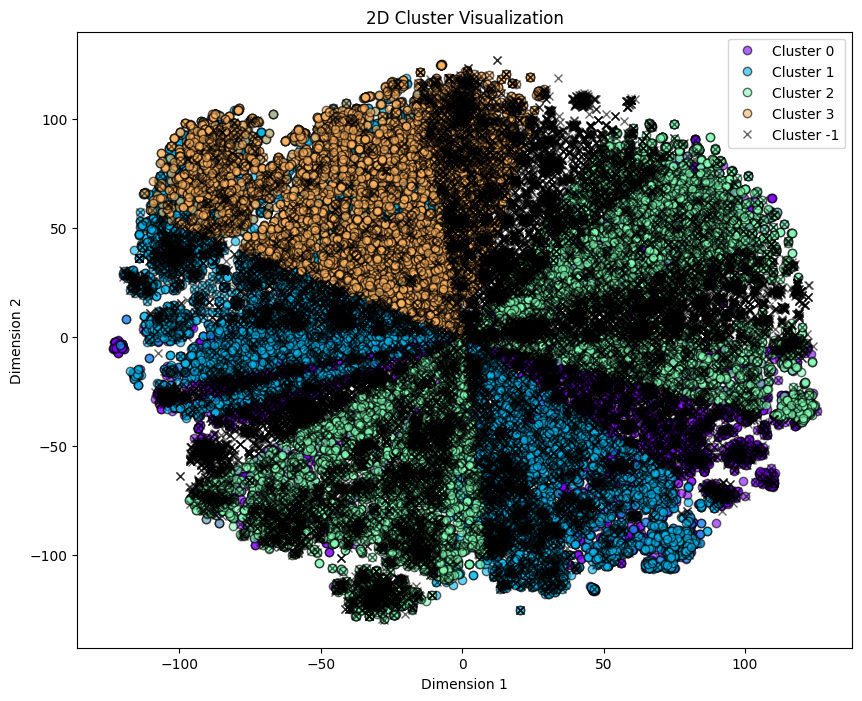

2024-06-19 04:06:58,248 - PreProcessingText - INFO - Extracting keywords from final clusters
2024-06-19 04:06:58,264 - PreProcessingText - INFO - 
Cluster 2, #11754 Elements


--------------------
[('bitcoinsuperbuycom', 0.2839), ('dutchdarknet', 0.2755), ('cyberbunker', 0.2699), ('bitcoinprivacy', 0.2639), ('mined', 0.2604)]


2024-06-19 04:16:19,142 - PreProcessingText - INFO - 
Cluster 1, #14438 Elements


[('mining dn', 0.3454), ('mined bitcoins', 0.3387), ('daemon ethereum', 0.3204), ('node tor', 0.3062), ('owed bitcoin', 0.3046)]
--------------------
--------------------
[('bitcoinfrauder', 0.2799), ('hackerforhire', 0.2455), ('bitcoinbillionaire', 0.2402), ('bitcoinsuperbuycom', 0.2362), ('miner', 0.2355)]


2024-06-19 04:28:05,579 - PreProcessingText - INFO - 
Cluster 0, #11140 Elements


[('bitcoin monero', 0.3738), ('bitcoinsuperbuycom crosspost', 0.3722), ('monero bitcoin', 0.3692), ('bitcoins tor', 0.3664), ('bitcoin crosspost', 0.3664)]
--------------------
--------------------
[('darkwebmarket', 0.3758), ('darknetmarkets', 0.3715), ('darknetmarketbusts', 0.366), ('darknetmarketsoz', 0.3647), ('darkmarketsbrasil', 0.3553)]


2024-06-19 04:36:05,833 - PreProcessingText - INFO - 
Cluster 3, #7445 Elements


[('banned darknetmarkets', 0.5328), ('crosspost darknetmarkets', 0.4429), ('vendor darknetmarketsno', 0.4233), ('darkmarket selling', 0.4222), ('vendor banned', 0.4127)]
--------------------
--------------------
[('cannabisozkings', 0.4074), ('cannabiscup', 0.4065), ('cannabiselite', 0.4039), ('cannabis', 0.397), ('cannabiskingz', 0.3933)]
[('cannabis wholesale', 0.4906), ('cannabis bargain', 0.4784), ('wholesale cannabis', 0.4783), ('flower cannabis', 0.4776), ('cannabis flower', 0.4768)]
--------------------


In [24]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_words=30, hdbscan=True, min_cluster_size=0.03)
res.to_csv("Results_Cluster/distiluse_tSNE_hdbscan_0.03_window30.csv", index=False)

### HDBScan + tSNE + KeyBERT + Distiluse + 0.2

2024-06-19 04:43:04,151 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [17:16<00:00,  1.01it/s]
2024-06-19 05:00:21,141 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-19 05:10:40,799 - PreProcessingText - INFO - Starting clustering with HDBSCAN in batches


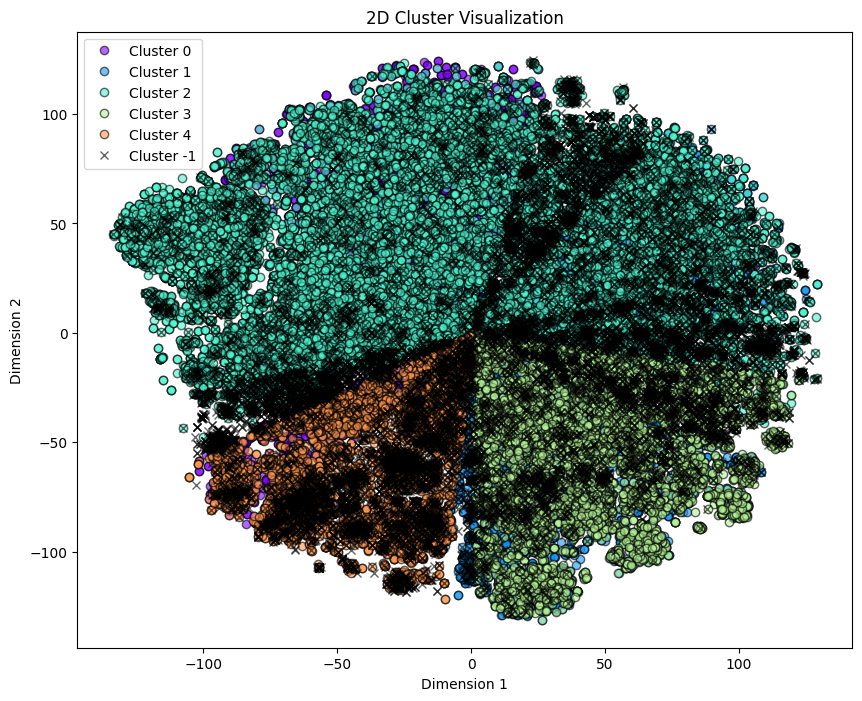

2024-06-19 05:10:56,973 - PreProcessingText - INFO - Extracting keywords from final clusters
2024-06-19 05:10:56,973 - PreProcessingText - INFO - 
Cluster 2, #24278 Elements


--------------------
[('tonysdrugstore', 0.2906), ('tor', 0.271), ('cannabissexpress', 0.2701), ('cannabiskingz', 0.2692), ('torum', 0.2672)]


2024-06-19 05:27:10,543 - PreProcessingText - INFO - 
Cluster 1, #9419 Elements


[('tinyrockvendor cannabis', 0.3542), ('tor node', 0.3508), ('tor exploit', 0.3428), ('node tor', 0.3394), ('new cannabis', 0.339)]
--------------------
--------------------
[('bitcoinfrauder', 0.2799), ('hackerforhire', 0.2455), ('bitcoinbillionaire', 0.2402), ('bitcoinsuperbuycom', 0.2362), ('miner', 0.2355)]


2024-06-19 05:34:20,822 - PreProcessingText - INFO - 
Cluster 0, #7171 Elements


[('bitcoin monero', 0.3738), ('bitcoinsuperbuycom crosspost', 0.3722), ('monero bitcoin', 0.3692), ('bitcoins tor', 0.3664), ('bitcoin crosspost', 0.3664)]
--------------------
--------------------
[('darknetmarket', 0.3765), ('nightmaremarket', 0.3602), ('dreammarket', 0.3561), ('darkmarket', 0.3285), ('drugmartblackdreamz', 0.3249)]


2024-06-19 05:41:27,096 - PreProcessingText - INFO - 
Cluster 3, #6722 Elements


[('narcotic dreammarket', 0.4541), ('dreammarket scammed', 0.4376), ('vendor drugmartblackdreamz', 0.4303), ('vendor dreammarket', 0.4264), ('scamming nightmaremarket', 0.4254)]
--------------------
--------------------
[('bitcoinlaundering', 0.3803), ('bitcoinbillionaire', 0.3503), ('bitcoinpostage', 0.3184), ('localbitcoins', 0.2786), ('bitcoin', 0.2766)]


2024-06-19 05:47:00,212 - PreProcessingText - INFO - 
Cluster 4, #5073 Elements


[('bitcoin withdraw', 0.4554), ('bitcoin withdrawl', 0.4553), ('withdraw bitcoin', 0.4499), ('withdraw bitcoins', 0.4491), ('bitcoinbillionaire scammer', 0.4393)]
--------------------
--------------------
[('empiremoderator', 0.3964), ('empiremoderatorb', 0.3926), ('empires', 0.3858), ('empirestill', 0.3847), ('empiremaket', 0.3821)]
[('empire mods', 0.5031), ('empire fuck', 0.5), ('empire mod', 0.4991), ('fuck empire', 0.4972), ('fuck empirestill', 0.4941)]
--------------------


In [25]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_words=30, hdbscan=True, min_cluster_size=0.02)
res.to_csv("Results_Cluster/distiluse_tSNE_hdbscan_0.02_window30.csv", index=False)

### HDBScan Not Batch + tSNE + KeyBERT + Distiluse + 0.04

2024-06-20 07:01:56,309 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [17:51<00:00,  1.03s/it]
2024-06-20 07:19:48,608 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-20 07:29:09,880 - PreProcessingText - INFO - Starting clustering with HDBSCAN


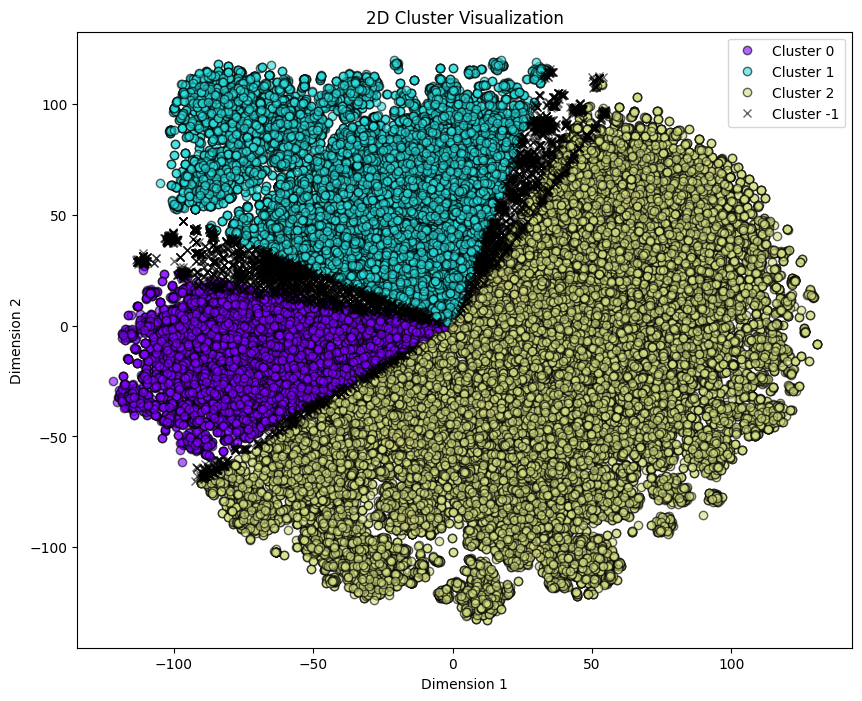

2024-06-20 07:30:50,597 - PreProcessingText - INFO - Evaluating Silhouette Score
2024-06-20 07:31:53,511 - PreProcessingText - INFO - Silhouette Score: 0.3781430423259735
2024-06-20 07:31:53,511 - PreProcessingText - INFO - Evaluating Davies-Bouldin Index
2024-06-20 07:31:53,527 - PreProcessingText - INFO - Davies-Bouldin Index: 0.7502500493378127
2024-06-20 07:31:53,527 - PreProcessingText - INFO - Extracting keywords from final clusters
Processing clusters:   0%|          | 0/3 [00:00<?, ?it/s]2024-06-20 07:32:03,365 - PreProcessingText - INFO - 
Cluster 2, #38717 Elements
2024-06-20 07:32:03,512 - PreProcessingText - INFO - Extracting top 5 keywords from cluster
2024-06-20 07:33:54,214 - PreProcessingText - INFO - 1-gram topics: [('torbrowser', 0.3171), ('tor', 0.2933), ('torrc', 0.287), ('torum', 0.2721), ('torpremier', 0.2716)]
2024-06-20 07:51:20,096 - PreProcessingText - INFO - 1-2-gram topics: [('tor exploit', 0.4105), ('tor bug', 0.3998), ('tor browser', 0.3988), ('tor darknet

In [3]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_words=30, hdbscan=True, hdbscan_batches=False, min_cluster_size=0.04)
res.to_csv("Results_Cluster/distiluse_tSNE_hdbscan_notbatch_0.04_window30.csv", index=False)

### HDBScan Not Batch + tSNE + KeyBERT + Distiluse + 0.03

2024-06-20 05:30:19,539 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [16:12<00:00,  1.07it/s]
2024-06-20 05:46:32,725 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-20 05:55:57,609 - PreProcessingText - INFO - Starting clustering with HDBSCAN


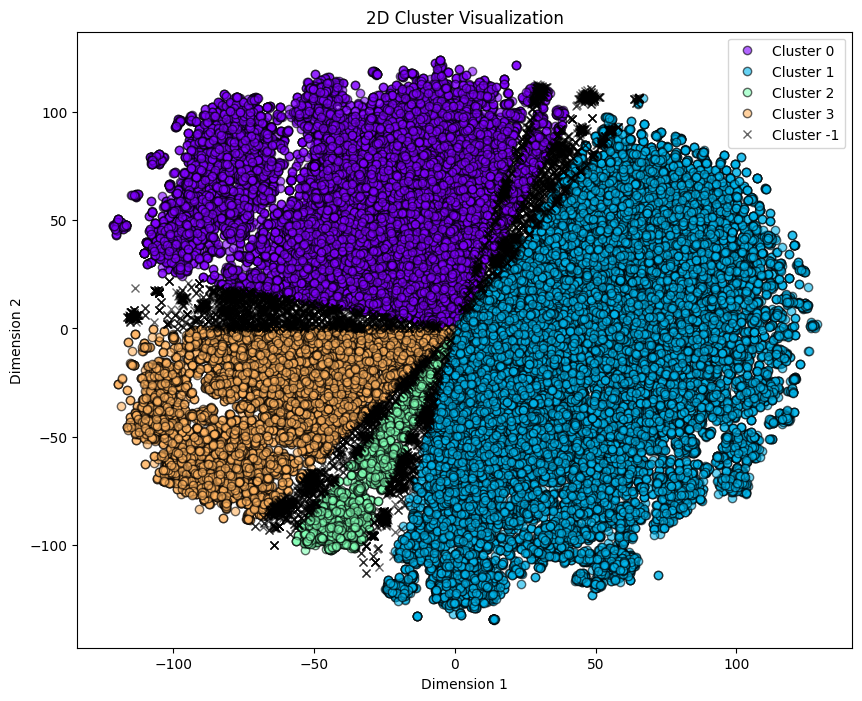

2024-06-20 05:56:41,501 - PreProcessingText - INFO - Evaluating Silhouette Score
2024-06-20 05:57:54,619 - PreProcessingText - INFO - Silhouette Score: 0.2830639183521271
2024-06-20 05:57:54,619 - PreProcessingText - INFO - Evaluating Davies-Bouldin Index
2024-06-20 05:57:54,665 - PreProcessingText - INFO - Davies-Bouldin Index: 1.5187917126003838
2024-06-20 05:57:54,665 - PreProcessingText - INFO - Extracting keywords from final clusters
Processing clusters:   0%|          | 0/4 [00:00<?, ?it/s]2024-06-20 05:58:04,801 - PreProcessingText - INFO - 
Cluster 1, #31197 Elements
2024-06-20 05:58:05,016 - PreProcessingText - INFO - Extracting top 5 keywords from cluster
2024-06-20 05:59:40,073 - PreProcessingText - INFO - 1-gram topics: [('torbrowser', 0.3341), ('tor', 0.3094), ('torrc', 0.3011), ('torpremier', 0.2939), ('torum', 0.2883)]
2024-06-20 06:13:41,249 - PreProcessingText - INFO - 1-2-gram topics: [('tor browser', 0.4365), ('tor error', 0.4087), ('tor bug', 0.4073), ('tor torstree

In [5]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_words=30, hdbscan=True, hdbscan_batches=False, min_cluster_size=0.03)
res.to_csv("Results_Cluster/distiluse_tSNE_hdbscan_notbatch_0.03_window30.csv", index=False)

### HDBScan Not Batch + tSNE + KeyBERT + Distiluse + 0.2

2024-06-19 10:47:33,731 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [18:22<00:00,  1.06s/it]
2024-06-19 11:05:57,124 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-19 11:15:50,530 - PreProcessingText - INFO - Starting clustering with HDBSCAN


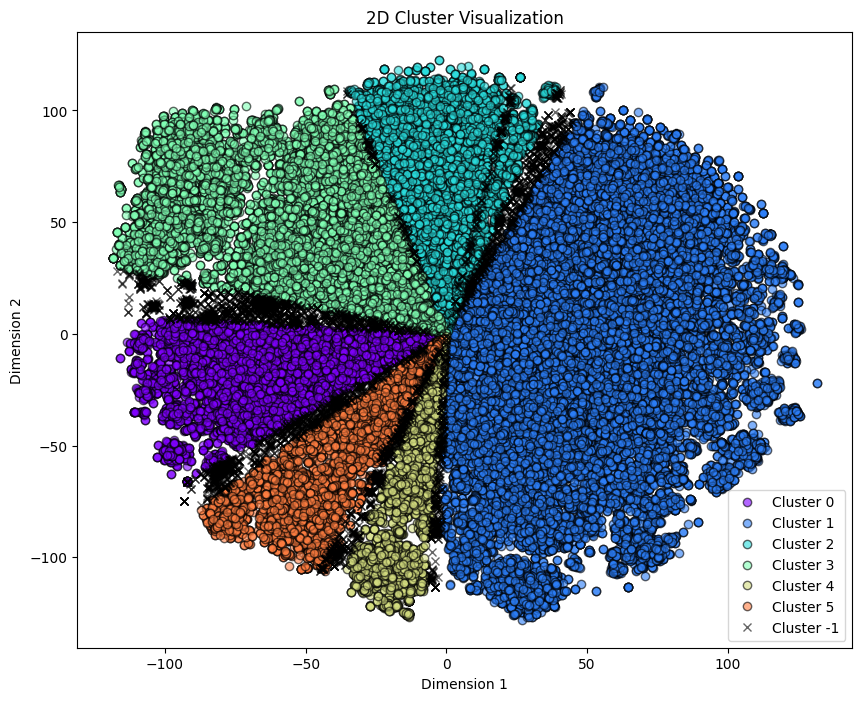

2024-06-19 11:16:25,989 - PreProcessingText - INFO - Extracting keywords from final clusters
2024-06-19 11:16:25,989 - PreProcessingText - INFO - 
Cluster 1, #29622 Elements


--------------------
[('torbrowser', 0.3341), ('tor', 0.3094), ('torrc', 0.3011), ('torpremier', 0.2939), ('torum', 0.2883)]


2024-06-19 11:33:57,028 - PreProcessingText - INFO - 
Cluster 5, #4805 Elements


[('tor browser', 0.4365), ('tor error', 0.4087), ('tor bug', 0.4073), ('tor torstreet', 0.4006), ('hack tor', 0.3984)]
--------------------
--------------------
[('darknetmarketsorg', 0.4315), ('darknetmarketslist', 0.4288), ('darknetmarketbusts', 0.4242), ('darknetmarket', 0.4232), ('darknetmarkets', 0.4207)]


2024-06-19 11:38:42,263 - PreProcessingText - INFO - 
Cluster 3, #12181 Elements


[('darknetmarkets ban', 0.5864), ('banned darknetmarkets', 0.5845), ('darknetmarkets banned', 0.5834), ('darknetmarketsnoobs banned', 0.5754), ('market darknetmarketslist', 0.4872)]
--------------------
--------------------
[('cannabissexpress', 0.4572), ('kidcannabis', 0.4437), ('cannabisagent', 0.4407), ('cannabisinduced', 0.4343), ('cannabisozkings', 0.4328)]


2024-06-19 11:48:48,595 - PreProcessingText - INFO - 
Cluster 2, #6372 Elements


[('cannabis wholesale', 0.5216), ('kidcannabis vendor', 0.5161), ('wholesale cannabis', 0.5114), ('selling cannabis', 0.5111), ('cannabis bargain', 0.5017)]
--------------------
--------------------
[('tbigcoinmexicanbrokersmonerocardingstotedarknet', 0.3263), ('nmethylamphetamine', 0.3217), ('canadapharmacy', 0.3185), ('canadianpharmacy', 0.3154), ('cannabinoids', 0.3085)]


2024-06-19 11:54:43,007 - PreProcessingText - INFO - 
Cluster 0, #6716 Elements


[('cannabinol best', 0.4304), ('best ketamine', 0.4279), ('drugwick best', 0.4153), ('ketamine best', 0.4145), ('best methamphetamine', 0.4075)]
--------------------
--------------------
[('mdmadirtsharkresellers', 0.375), ('vendorbbmc', 0.3136), ('wholesaler', 0.2994), ('wholesaleraus', 0.2963), ('vendedor', 0.2929)]


2024-06-19 12:00:27,944 - PreProcessingText - INFO - 
Cluster 4, #3106 Elements


[('mdma vendor', 0.4261), ('mdma vendors', 0.4222), ('vendor mdma', 0.4138), ('md vendor', 0.4134), ('mushmerica vendor', 0.4124)]
--------------------
--------------------
[('empirestill', 0.37), ('empire', 0.354), ('empires', 0.3443), ('imperiya', 0.3291), ('empiremoderatorb', 0.3199)]
[('dream empire', 0.5328), ('empire dream', 0.5306), ('empire nightmare', 0.5293), ('nightmare empire', 0.5176), ('darkestnightmare empire', 0.4779)]
--------------------


In [5]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_words=30, hdbscan=True, hdbscan_batches=False, min_cluster_size=0.02)
res.to_csv("Results_Cluster/distiluse_tSNE_hdbscan_notbatch_0.02_window30.csv", index=False)

### HDBScan Not Batch + tSNE + KeyBERT + Distiluse + 0.01

2024-06-19 12:04:20,242 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [20:46<00:00,  1.20s/it]
2024-06-19 12:25:07,336 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-19 12:35:44,228 - PreProcessingText - INFO - Starting clustering with HDBSCAN


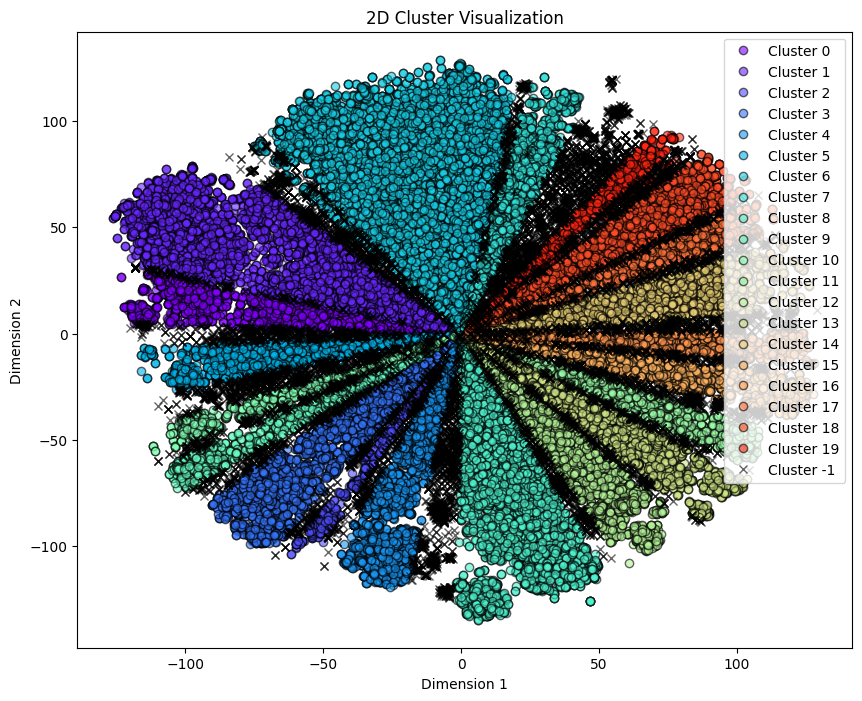

2024-06-19 12:36:09,988 - PreProcessingText - INFO - Extracting keywords from final clusters
2024-06-19 12:36:09,994 - PreProcessingText - INFO - 
Cluster 13, #2412 Elements


--------------------
[('tor', 0.2221), ('torbrowser', 0.2187), ('torwebsitescom', 0.2163), ('deepdotweb', 0.2042), ('security', 0.1927)]


2024-06-19 12:38:33,554 - PreProcessingText - INFO - 
Cluster 8, #5684 Elements


[('tor safest', 0.3595), ('tor security', 0.3531), ('safest tor', 0.3488), ('safe tor', 0.3409), ('security deepdotweb', 0.3399)]
--------------------
--------------------
[('bitcoinlaundering', 0.4661), ('bitcoinfrauder', 0.452), ('bitcoinpostage', 0.4425), ('bitcoinbillionaire', 0.4263), ('bitcoins', 0.4139)]


2024-06-19 12:43:58,256 - PreProcessingText - INFO - 
Cluster 3, #3227 Elements


[('counterfeit bitcoins', 0.5148), ('bitcoinbillionaire scammer', 0.499), ('mined bitcoins', 0.497), ('bitcoins monero', 0.4952), ('tracing bitcoins', 0.4894)]
--------------------
--------------------
[('darkwebmarket', 0.4163), ('darknetmarketslist', 0.4122), ('darknetmarket', 0.4075), ('darknetmarkets', 0.4062), ('darknetmarketbusts', 0.4011)]


2024-06-19 12:47:00,135 - PreProcessingText - INFO - 
Cluster 12, #2660 Elements


[('darknetmarkets banned', 0.5826), ('darknetmarkets ban', 0.5777), ('banned darknetmarkets', 0.577), ('darknetmarketsnoobs banned', 0.5577), ('crosspost darknetmarkets', 0.4798)]
--------------------
--------------------
[('hacker', 0.2974), ('hacking', 0.2796), ('hack', 0.2786), ('hacks', 0.2621), ('misscrypto', 0.2528)]


2024-06-19 12:49:25,856 - PreProcessingText - INFO - 
Cluster 14, #2958 Elements


[('hacking developer', 0.4061), ('developer hacking', 0.4031), ('developer hacker', 0.3992), ('hacking developing', 0.3727), ('hacker lfw', 0.3663)]
--------------------
--------------------
[('thooooooooooootbot', 0.2537), ('bot', 0.2362), ('thotbot', 0.2296), ('lionsbreathog', 0.1907), ('lion', 0.1767)]


2024-06-19 12:51:41,615 - PreProcessingText - INFO - 
Cluster 19, #1138 Elements


[('thooooooooooootbot xmrto', 0.2766), ('lionsbreathog legit', 0.2723), ('thotbot xmrto', 0.2666), ('thooooooooooootbot', 0.2537), ('mining back', 0.2503)]
--------------------
--------------------
[('dutchdrugrally', 0.3377), ('dutchdopecrew', 0.3212), ('dutchdrugz', 0.3185), ('dutchbulk', 0.3184), ('dutchmastersuk', 0.3177)]


2024-06-19 12:52:57,804 - PreProcessingText - INFO - 
Cluster 16, #1429 Elements


[('dutchbulk bulk', 0.428), ('mdma dutch', 0.4257), ('dutch mdma', 0.4231), ('dutchcartel mdma', 0.4179), ('bulk dutchfarmernl', 0.4151)]
--------------------
--------------------
[('lions', 0.2601), ('leon', 0.2525), ('newbie', 0.2317), ('newb', 0.2217), ('questions', 0.2201)]


2024-06-19 12:54:17,591 - PreProcessingText - INFO - 
Cluster 15, #1978 Elements


[('new questions', 0.3209), ('newbie question', 0.3202), ('question newbie', 0.3171), ('new thread', 0.3146), ('newb question', 0.3128)]
--------------------
--------------------
[('monero', 0.2585), ('fake', 0.1981), ('burn', 0.1828), ('mining', 0.1773), ('faux', 0.1667)]


2024-06-19 12:55:54,483 - PreProcessingText - INFO - 
Cluster 18, #2566 Elements


[('monero mining', 0.3144), ('monero btc', 0.2975), ('fake ids', 0.2911), ('btc monero', 0.2892), ('fake id', 0.2872)]
--------------------
--------------------
[('dnms', 0.2299), ('dnm', 0.2279), ('dm', 0.223), ('looking', 0.221), ('md', 0.218)]


2024-06-19 12:58:11,133 - PreProcessingText - INFO - 
Cluster 6, #9871 Elements


[('dnm looking', 0.3745), ('looking lsd', 0.3495), ('lsd looking', 0.3448), ('dab looking', 0.3325), ('looking xmf', 0.3323)]
--------------------
--------------------
[('cannabisinduced', 0.4713), ('kidcannabis', 0.4696), ('cannabisinfused', 0.4623), ('cannabiscup', 0.4572), ('cannabisozkings', 0.4524)]


2024-06-19 13:06:20,158 - PreProcessingText - INFO - 
Cluster 17, #1327 Elements


[('cannabiselite dude', 0.5253), ('cannabis cannabis', 0.5247), ('cannabis xtc', 0.5234), ('cannabis gbmessicocaine', 0.5229), ('weed cannabiscup', 0.5207)]
--------------------
--------------------
[('found', 0.2482), ('find', 0.2439), ('happyshopperbulk', 0.2424), ('finding', 0.2291), ('gesucht', 0.2236)]


2024-06-19 13:07:30,909 - PreProcessingText - INFO - 
Cluster 7, #1714 Elements


[('happyshopperbulk find', 0.3817), ('find houselannister', 0.3569), ('stealth find', 0.3508), ('fucked find', 0.3328), ('fuckinfrenchtoast searching', 0.3319)]
--------------------
--------------------
[('mushroommafia', 0.354), ('lophophora', 0.3523), ('phenethylamine', 0.3415), ('phenylacetamide', 0.3393), ('phenethylamines', 0.3348)]


2024-06-19 13:10:02,505 - PreProcessingText - INFO - 
Cluster 10, #1072 Elements


[('bluphox weed', 0.417), ('fentanyl uk', 0.4152), ('weed cyprus', 0.406), ('uk mushroom', 0.4026), ('mushroom uk', 0.395)]
--------------------
--------------------
[('nightmaremarket', 0.3142), ('dreammarket', 0.3133), ('narcotics', 0.2903), ('narcoticsanonymousau', 0.2853), ('narcotic', 0.2763)]


2024-06-19 13:11:21,549 - PreProcessingText - INFO - 
Cluster 11, #1593 Elements


[('narcotics dream', 0.4872), ('narcotic dream', 0.4781), ('vendors dream', 0.4645), ('dream vendors', 0.4641), ('dream vendor', 0.4607)]
--------------------
--------------------
[('site', 0.2323), ('website', 0.2219), ('blackmail', 0.1955), ('airbnb', 0.192), ('darkweb', 0.1806)]


2024-06-19 13:12:59,034 - PreProcessingText - INFO - 
Cluster 0, #2125 Elements


[('rank site', 0.3166), ('site help', 0.3042), ('messing site', 0.3038), ('favorite site', 0.2899), ('bomber blackmail', 0.2894)]
--------------------
--------------------
[('dutchmasters', 0.2885), ('dutchmastersuk', 0.2879), ('dutchxmdma', 0.2639), ('shipper', 0.2477), ('vendedor', 0.2406)]


2024-06-19 13:15:13,406 - PreProcessingText - INFO - 
Cluster 9, #1404 Elements


[('dutchxmdma vendor', 0.4286), ('dutchmasters vendor', 0.4085), ('vendor uk', 0.4049), ('supplier uk', 0.4034), ('ship uk', 0.4034)]
--------------------
--------------------
[('nightmaremarket', 0.3505), ('dreammarket', 0.34), ('dreamarket', 0.3149), ('darkmarket', 0.2918), ('dreammarketmod', 0.2869)]


2024-06-19 13:17:09,389 - PreProcessingText - INFO - 
Cluster 5, #1986 Elements


[('scam dreammarket', 0.4573), ('darkmarket counterfeit', 0.4545), ('dreammarket scammed', 0.4525), ('scamming nightmaremarket', 0.4427), ('euro counterfeit', 0.4423)]
--------------------
--------------------
[('vendedor', 0.3254), ('vendorstore', 0.3201), ('vendor', 0.3101), ('venditori', 0.2977), ('vendedores', 0.2967)]


2024-06-19 13:19:19,468 - PreProcessingText - INFO - 
Cluster 1, #5777 Elements


[('looking vendor', 0.4127), ('trustworth vendor', 0.4118), ('trustworthy vendor', 0.4064), ('vendor gesucht', 0.4055), ('vendor trustworthy', 0.4049)]
--------------------
--------------------
[('vendorshop', 0.2381), ('vendorbubblehash', 0.2353), ('wholesale', 0.2315), ('vendor', 0.2229), ('supplier', 0.2117)]


2024-06-19 13:24:41,155 - PreProcessingText - INFO - 
Cluster 4, #3051 Elements


[('vape vendor', 0.3399), ('cartridge vendor', 0.3387), ('ukbased vendor', 0.3385), ('vendor vape', 0.3317), ('sell vape', 0.3258)]
--------------------
--------------------
[('empiredealer', 0.3393), ('empirestill', 0.3325), ('empiremarketurlcom', 0.3091), ('empires', 0.3073), ('empiremoderator', 0.3055)]


2024-06-19 13:27:49,255 - PreProcessingText - INFO - 
Cluster 2, #695 Elements


[('empire scammer', 0.4772), ('scammer empire', 0.4689), ('empire scamming', 0.4687), ('empire scammed', 0.4672), ('empire scam', 0.465)]
--------------------
--------------------
[('dreammarket', 0.3203), ('weaverofdreams', 0.2916), ('dreams', 0.2864), ('dream', 0.2804), ('reddreamingteam', 0.2234)]
[('global dreams', 0.4133), ('dream cryptoednl', 0.3852), ('scammed dream', 0.3846), ('dream gotmilkforums', 0.3833), ('sweetworld dream', 0.3826)]
--------------------


In [6]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_words=30, hdbscan=True, hdbscan_batches=False, min_cluster_size=0.01)
res.to_csv("Results_Cluster/distiluse_tSNE_hdbscan_notbatch_0.01_window30.csv", index=False)

### KMeans 10 cluster + UMAP + KeyBERT + Distiluse

2024-06-19 17:10:46,664 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [19:40<00:00,  1.13s/it]
2024-06-19 17:30:27,792 - PreProcessingText - INFO - Performing dimensionality reduction with UMAP in batches
2024-06-19 17:30:27,814 - PreProcessingText - INFO - Reducing batch 1/2
2024-06-19 17:30:56,935 - PreProcessingText - INFO - Reducing batch 2/2
2024-06-19 17:31:24,617 - PreProcessingText - INFO - Starting clustering with MiniBatch K-Means Clustering


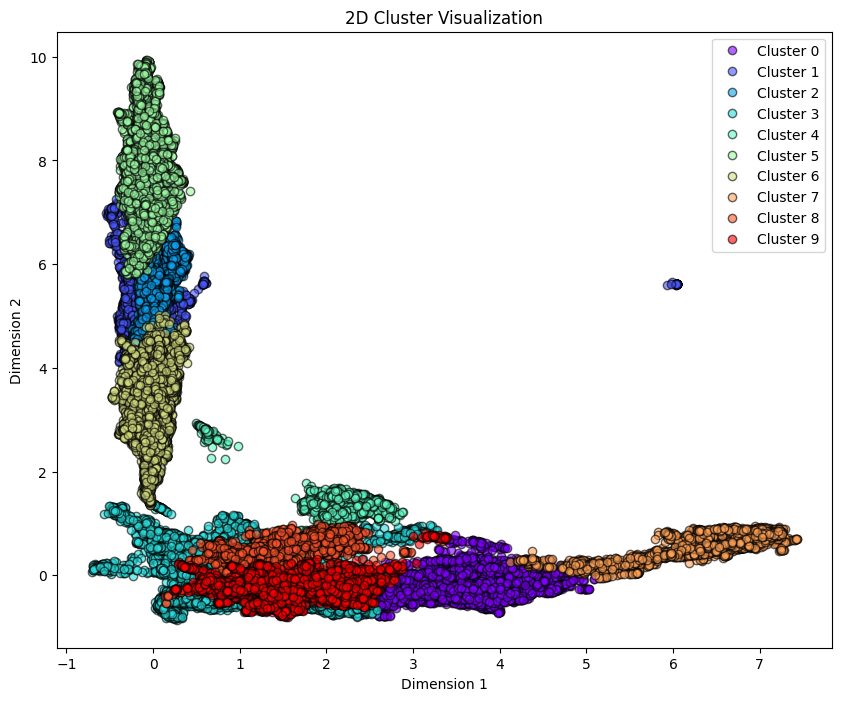

2024-06-19 17:31:25,753 - PreProcessingText - INFO - Extracting keywords from final clusters
Processing clusters:   0%|          | 0/10 [00:00<?, ?it/s]2024-06-19 17:31:34,399 - PreProcessingText - INFO - 
Cluster 1, #8196 Elements
2024-06-19 17:31:34,415 - PreProcessingText - INFO - Extracting top 5 keywords from cluster
2024-06-19 17:32:17,305 - PreProcessingText - INFO - 1-gram topics: [('tor', 0.2156), ('dutchgermanteam', 0.203), ('dutchdreamzz', 0.19), ('dutchhq', 0.1886), ('tom', 0.1859)]
2024-06-19 17:36:21,334 - PreProcessingText - INFO - 1-2-gram topics: [('antminer wiki', 0.2667), ('tor shrinked', 0.2588), ('tor anybody', 0.2519), ('tor running', 0.2492), ('tor im', 0.2468)]
Processing clusters:  10%|█         | 1/10 [04:46<43:02, 286.93s/it]2024-06-19 17:36:21,334 - PreProcessingText - INFO - 
Cluster 6, #8495 Elements
2024-06-19 17:36:21,350 - PreProcessingText - INFO - Extracting top 5 keywords from cluster
2024-06-19 17:36:59,128 - PreProcessingText - INFO - 1-gram topics

In [6]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_clusters=10, n_words=30, k_means=True, reduction='UMAP')
res.to_csv("Results_Cluster/distiluse_UMAP_kmeans_10_window30.csv", index=False)

### Agglomerative 4 cluster 22250 + tSNE + KeyBERT + Distiluse

2024-06-20 08:06:12,061 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [16:23<00:00,  1.06it/s]
2024-06-20 08:22:35,543 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-20 08:31:50,143 - PreProcessingText - INFO - Starting clustering with Agglomerative Clustering in batches


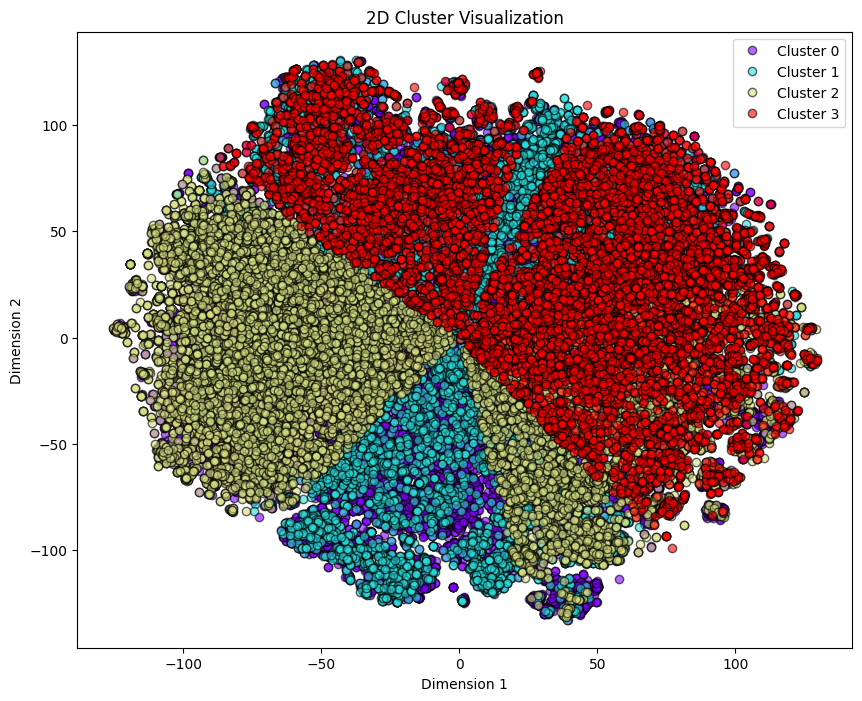

2024-06-20 08:32:44,271 - PreProcessingText - INFO - Evaluating Silhouette Score
2024-06-20 08:33:56,075 - PreProcessingText - INFO - Silhouette Score: -0.03597323223948479
2024-06-20 08:33:56,075 - PreProcessingText - INFO - Evaluating Davies-Bouldin Index
2024-06-20 08:33:56,101 - PreProcessingText - INFO - Davies-Bouldin Index: 6.673294677390905
2024-06-20 08:33:56,101 - PreProcessingText - INFO - Extracting keywords from final clusters
Processing clusters:   0%|          | 0/4 [00:00<?, ?it/s]2024-06-20 08:34:04,577 - PreProcessingText - INFO - 
Cluster 3, #11446 Elements
2024-06-20 08:34:04,725 - PreProcessingText - INFO - Extracting top 5 keywords from cluster
2024-06-20 08:34:59,422 - PreProcessingText - INFO - 1-gram topics: [('tor', 0.3099), ('torum', 0.3057), ('torpremier', 0.2926), ('togethor', 0.2621), ('monereo', 0.2491)]
2024-06-20 08:40:48,071 - PreProcessingText - INFO - 1-2-gram topics: [('tor browser', 0.4345), ('updated tor', 0.4222), ('tor error', 0.405), ('tor bug'

In [4]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_clusters=4, n_words=30, batch_cluster_size=22250)
res.to_csv("Results_Cluster/distiluse_tSNE_agglomerative_4_22250_window30.csv", index=False)

### Agglomerative 5 cluster 22250 + tSNE + KeyBERT + Distiluse

2024-06-19 21:55:19,113 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [26:05<00:00,  1.50s/it]
2024-06-19 22:21:25,432 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-19 22:31:37,474 - PreProcessingText - INFO - Starting clustering with Agglomerative Clustering in batches


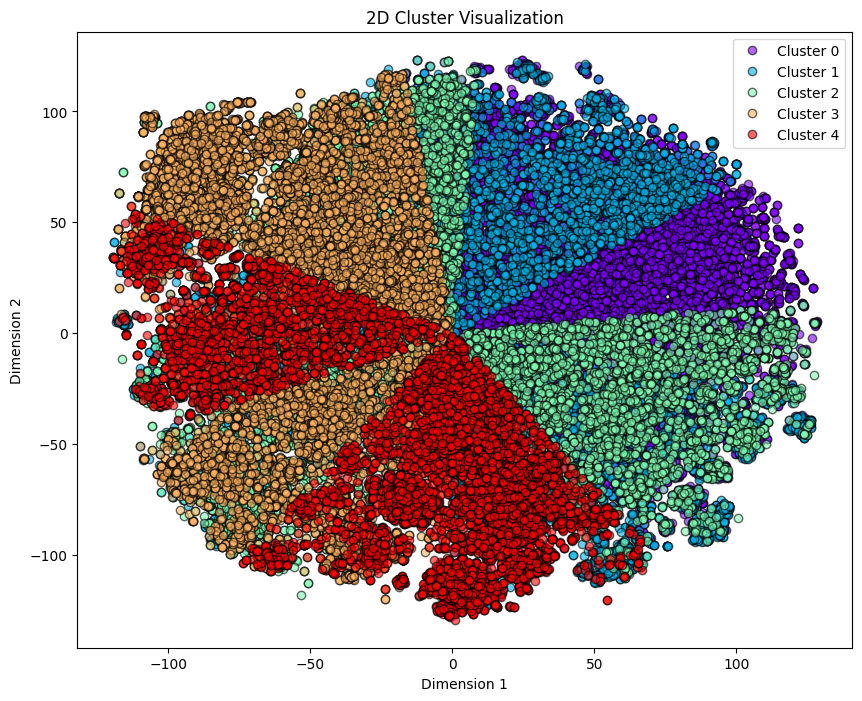

2024-06-19 22:34:15,120 - PreProcessingText - INFO - Extracting keywords from final clusters
Processing clusters:   0%|          | 0/5 [00:00<?, ?it/s]2024-06-19 22:34:24,776 - PreProcessingText - INFO - 
Cluster 0, #17549 Elements
2024-06-19 22:34:24,917 - PreProcessingText - INFO - Extracting top 5 keywords from cluster
2024-06-19 22:35:52,931 - PreProcessingText - INFO - 1-gram topics: [('torrc', 0.2361), ('torbrowser', 0.225), ('tor', 0.2244), ('hackerforhire', 0.2187), ('dutchhq', 0.1947)]
2024-06-19 22:45:36,071 - PreProcessingText - INFO - 1-2-gram topics: [('electrum tor', 0.2985), ('hack tor', 0.2821), ('antminer back', 0.277), ('help tor', 0.2744), ('tor lsd', 0.2662)]
Processing clusters:  20%|██        | 1/5 [11:11<44:45, 671.30s/it]2024-06-19 22:45:36,071 - PreProcessingText - INFO - 
Cluster 2, #13565 Elements
2024-06-19 22:45:36,087 - PreProcessingText - INFO - Extracting top 5 keywords from cluster
2024-06-19 22:46:49,898 - PreProcessingText - INFO - 1-gram topics: [('t

In [9]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_clusters=5, n_words=30, batch_cluster_size=22250)
res.to_csv("Results_Cluster/distiluse_tSNE_agglomerative_5_22250_window30.csv", index=False)

### Agglomerative 3 cluster 22250 + tSNE + KeyBERT + Distiluse

2024-06-20 00:18:19,708 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1043/1043 [18:26<00:00,  1.06s/it]
2024-06-20 00:36:46,615 - PreProcessingText - INFO - Performing dimensionality reduction with incremental t-SNE
2024-06-20 00:46:40,435 - PreProcessingText - INFO - Starting clustering with Agglomerative Clustering in batches


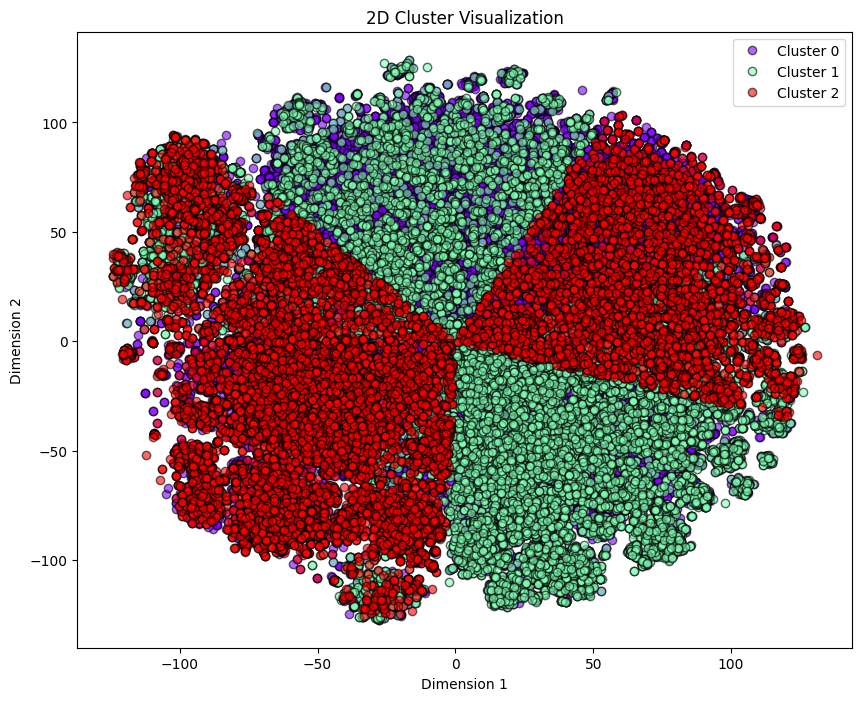

2024-06-20 00:48:03,813 - PreProcessingText - INFO - Extracting keywords from final clusters
Processing clusters:   0%|          | 0/3 [00:00<?, ?it/s]2024-06-20 00:48:12,990 - PreProcessingText - INFO - 
Cluster 0, #30602 Elements
2024-06-20 00:48:13,140 - PreProcessingText - INFO - Extracting top 5 keywords from cluster
2024-06-20 00:50:00,813 - PreProcessingText - INFO - 1-gram topics: [('tonysdrugstore', 0.2736), ('torrc', 0.2705), ('tor', 0.2645), ('tonystarkweed', 0.2552), ('torbrowser', 0.251)]
2024-06-20 01:05:45,767 - PreProcessingText - INFO - 1-2-gram topics: [('tor node', 0.3596), ('node tor', 0.3514), ('tor exploit', 0.3157), ('bitcoin tumbler', 0.3157), ('weed tllqrhac', 0.3101)]
Processing clusters:  33%|███▎      | 1/3 [17:32<35:05, 1052.78s/it]2024-06-20 01:05:45,769 - PreProcessingText - INFO - 
Cluster 1, #19582 Elements
2024-06-20 01:05:45,797 - PreProcessingText - INFO - Extracting top 5 keywords from cluster
2024-06-20 01:07:27,419 - PreProcessingText - INFO - 1-g

In [3]:
tc = ppt.TextClustering(df, 'name_thread')
summarized_clusters, cluster_df, res = tc.main(name_model='distiluse-base-multilingual-cased-v1', batch_size=64, n_clusters=3, n_words=30, batch_cluster_size=22250)
res.to_csv("Results_Cluster/distiluse_tSNE_agglomerative_3_22250_window30.csv", index=False)

**Approach that as seen works very well and succeeds in clustering, the best results were obtained with k-means having 6/7 clusters, as also evidenced by the Silhouette Score and davies_bouldin_score**

## 4° Approach: BERTopic

In [2]:
df = pd.read_csv('cleaned_data_name_thread.csv')
df = df.dropna(subset=['name_thread'])
df = df.drop_duplicates(subset=['name_thread'], keep='first')
df.shape[0]

66735

In [3]:
model = SentenceTransformer('distiluse-base-multilingual-cased-v1')
tc1 = ppt.TextClustering(df, 'name_thread')
tc1.encode_corpus(model, batch_size=64, to_tensor=False)

2024-06-25 18:13:12,124 - PreProcessingText - INFO - Encoding the corpus. This might take a while.
Batches: 100%|██████████| 1024/1024 [49:10<00:00,  2.88s/it]


array([[-0.05596191, -0.02048208, -0.0408654 , ...,  0.08593359,
         0.00841053,  0.050496  ],
       [ 0.04792455,  0.03172958, -0.00972225, ...,  0.08062411,
        -0.01151249,  0.01218798],
       [ 0.03451192, -0.00469939, -0.02061377, ..., -0.00406794,
        -0.05484711,  0.01487001],
       ...,
       [-0.02473538,  0.03251029, -0.04452128, ...,  0.00017893,
        -0.03766498,  0.03074655],
       [ 0.01396964,  0.01344143,  0.00063247, ..., -0.04474387,
        -0.02578878,  0.03929782],
       [ 0.06482894,  0.03406253, -0.07691094, ...,  0.02101658,
         0.01186585, -0.04680967]], dtype=float32)

In [5]:
len(tc1.corpus), len(tc1.corpus_embeddings)

(65529, 65529)

In [112]:
seed_topic_list = [[
    'tor site', 'drug', 'cocaine', 'ketamine', 'weed', 'trafficking', 'scammer', 'market', 'vendor', 'bitcoin',
    'mdma', 'coke', 'lsd', 'heroine', 'xanax', 'tor node', 'tor site', 'gun', 'weapon', 'hacking'
]]

zeroshot_topic_list = [pd.read_csv('../../../intent_crime.csv')['intent'].tolist()]

representation_model = MaximalMarginalRelevance(diversity=0.3)
vectorizer_model = CountVectorizer(stop_words="english")
ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True)
umap_model = UMAP(n_neighbors=15, n_components=10, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=1200, metric='euclidean', cluster_selection_method='eom', prediction_data=True)

topic_model = BERTopic(
    language='multilingual',
    top_n_words=10, 
    n_gram_range=(1, 2),
    umap_model=umap_model, 
    hdbscan_model=hdbscan_model, 
    seed_topic_list=seed_topic_list, 
    vectorizer_model=vectorizer_model, 
    ctfidf_model=ctfidf_model, 
    representation_model=representation_model,
    zeroshot_topic_list=zeroshot_topic_list, 
    zeroshot_min_similarity=.05, 
    verbose=True
)

topics, probs = topic_model.fit_transform(tc1.corpus, tc1.corpus_embeddings)

2024-06-25 22:09:26,662 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-06-25 22:11:33,616 - BERTopic - Dimensionality - Completed ✓
2024-06-25 22:11:33,650 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-06-25 22:13:00,249 - BERTopic - Cluster - Completed ✓
2024-06-25 22:13:00,707 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-06-25 22:13:05,923 - BERTopic - Representation - Completed ✓


In [113]:
print(topic_model.get_topic_info())
for topic_id in set(topics):
    print(f"Topic {topic_id}:")
    print(topic_model.get_topic(topic_id))

   Topic  Count                               Name  \
0     -1  34815            -1_new_free_help_ticket   
1      0   7477          0_weed_xanax_cocaine_coke   
2      1   6133    1_market_empire_dream_nightmare   
3      2   4908     2_vendor_scammer_scam_scamming   
4      3   4122              3_mdma_lsd_shit_whats   
5      4   4053        4_review_vendor_feedback_mg   
6      5   2238  5_order_package_delivery_shipping   
7      6   1783       6_card_bitcoin_wallet_credit   

                                      Representation  \
0  [new, free, help, ticket, mdma, update, accoun...   
1  [weed, xanax, cocaine, coke, ketamine, mg, can...   
2  [market, empire, dream, nightmare, vendor, mar...   
3  [vendor, scammer, scam, scamming, exit, scamme...   
4  [mdma, lsd, shit, whats, fuck, dead, thing, go...   
5  [review, vendor, feedback, mg, mdma, sample, r...   
6  [order, package, delivery, shipping, shipped, ...   
7  [card, bitcoin, wallet, credit, carding, coin,...   

        

In [114]:
umap_embeddings = topic_model.umap_model.fit_transform(tc1.corpus_embeddings)
indices = [index for index, topic in enumerate(topics) if topic != -1]
X=umap_embeddings[np.array(indices)]
labels = [topic for index, topic in enumerate(topics) if topic != -1]
silhouette_scores = silhouette_score(X, labels)
print(f"silhouette_score: {silhouette_scores}")
print(f"Davies_bouldin_score: {davies_bouldin_score(X, labels)}")

silhouette_score: 0.6377803087234497
Davies_bouldin_score: 0.5465497980291599


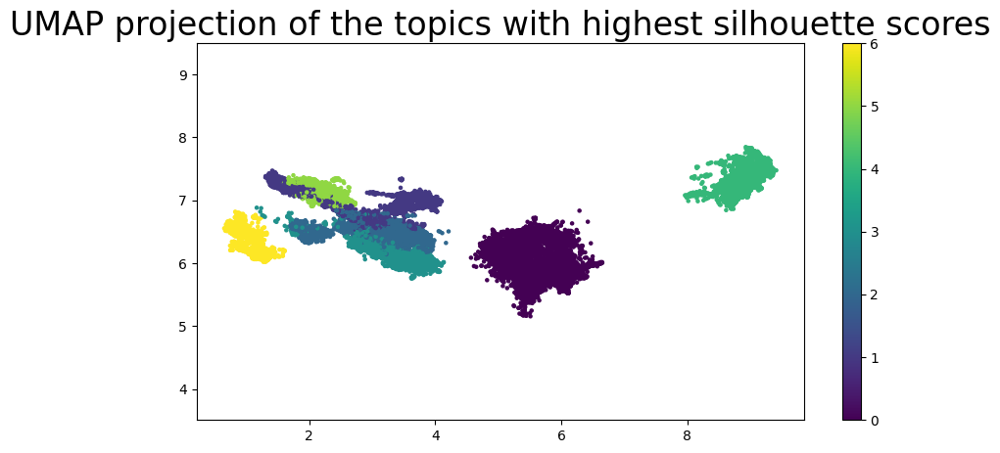

In [115]:
best_indices = np.argsort(silhouette_scores)[-10:]
best_umap_embeddings = umap_embeddings[best_indices]
plt.figure(figsize=(10, 5))
plt.scatter(X[:, 1], X[:, 2], c=labels, cmap='viridis', s=5)
plt.gca().set_aspect('equal', 'datalim')
plt.colorbar()
plt.title('UMAP projection of the topics with highest silhouette scores', fontsize=24)
plt.show()

In [116]:
vectorizer_model = CountVectorizer(stop_words="english", ngram_range=(1, 5))
topic_model.update_topics(tc1.corpus, vectorizer_model=vectorizer_model)

In [117]:
topic_model.get_topic_freq()

,Topic,Count
0,-1,34815
3,0,7477
4,1,6133
1,2,4908
5,3,4122
2,4,4053
6,5,2238
7,6,1783


In [118]:
print(topic_model.get_topic_info())
for topic_id in set(topics):
    print(f"Topic {topic_id}:")
    print(topic_model.get_topic(topic_id))

   Topic  Count                                         Name  \
0     -1  34815                      -1_vendor_new_free_help   
1      0   7477                       0_weed_vendor_xanax_mg   
2      1   6133                 1_market_empire_dream_vendor   
3      2   4908                2_vendor_scammer_scam_looking   
4      3   4122                         3_mdma_lsd_shit_good   
5      4   4053  4_review_vendor review_vendor_review vendor   
6      5   2238            5_order_package_shipping_delivery   
7      6   1783                 6_card_wallet_bitcoin_credit   

                                      Representation  \
0  [vendor, new, free, help, best, uk, account, n...   
1  [weed, vendor, xanax, mg, cocaine, uk, best, c...   
2  [market, empire, dream, vendor, nightmare, dre...   
3  [vendor, scammer, scam, looking, scamming, exi...   
4  [mdma, lsd, shit, good, got, whats, fuck, goin...   
5  [review, vendor review, vendor, review vendor,...   
6  [order, package, shipping, d

In [119]:
topic_model.visualize_topics()

In [120]:
topic_model.visualize_heatmap()

In [121]:
topic_model.visualize_hierarchy()

In [122]:
reduced_embeddings = UMAP(n_neighbors=15, n_components=2, 
                          min_dist=0.0, metric='cosine').fit_transform(tc1.corpus_embeddings)
topic_model.visualize_documents(tc1.corpus, reduced_embeddings=reduced_embeddings, 
                                hide_document_hover=True, hide_annotations=True)

In [144]:
new_topics = topic_model.reduce_outliers(tc1.corpus, topics, threshold=0.1, strategy='c-tf-idf')
topic_model.update_topics(tc1.corpus, topics=new_topics)

2024-06-25 22:33:07,995 - BERTopic - WARNING: Using a custom list of topic assignments may lead to errors if topic reduction techniques are used afterwards. Make sure that manually assigning topics is the last step in the pipeline.Note that topic embeddings will also be created through weightedc-TF-IDF embeddings instead of centroid embeddings.


In [145]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,31699,-1_anyone_new_help_free,"[anyone, new, help, free, please, need, ticket...",[new weed cartridge vendor rapture empire free...
1,0,7793,0_weed_xanax_mg_vendor,"[weed, xanax, mg, vendor, cocaine, uk, best, c...",[best uk weed vendor big bulk discount free sh...
2,1,6437,1_market_empire_dream_nightmare,"[market, empire, dream, nightmare, vendor, emp...","[dream market vendor bond, empire market exit ..."
3,2,6395,2_vendor_scammer_scam_looking,"[vendor, scammer, scam, looking, vendor vendor...","[vendor xtc selective scammer, warning scam al..."
4,3,4125,3_mdma_lsd_get_shit,"[mdma, lsd, get, shit, got, good, whats, fuck,...","[holy shit missed guy, whats point ddos people..."
5,4,4230,4_review_vendor review_vendor_review vendor,"[review, vendor review, vendor, review vendor,...","[vendor product review, heinekenexpress vendor..."
6,5,2749,5_order_package_shipping_delivery,"[order, package, shipping, delivery, shipped, ...",[placed order day ago finally marked shipped m...
7,6,2101,6_card_bitcoin_wallet_credit,"[card, bitcoin, wallet, credit, carding, btc, ...",[need fullz credit card bank account top dolla...


In [146]:
topic_model.visualize_documents(tc1.corpus, reduced_embeddings=reduced_embeddings, 
                                hide_document_hover=True, hide_annotations=True)

In [147]:
topic_model.visualize_hierarchy()

In [148]:
topic_model.visualize_topics()

In [156]:
umap_embeddings = topic_model.umap_model.fit_transform(tc1.corpus_embeddings)
indices = [index for index, topic in enumerate(new_topics) if topic != -1]
X=umap_embeddings[np.array(indices)]
labels = [topic for index, topic in enumerate(new_topics) if topic != -1]
silhouette_scores = silhouette_score(X, labels)
print(f"silhouette_score: {silhouette_scores}")
print(f"Davies_bouldin_score: {davies_bouldin_score(X, labels)}")

silhouette_score: 0.5603948831558228
Davies_bouldin_score: 0.7277847294313646


In [157]:
df['name_thread'] = df['name_thread'].str.lower().dropna()
df.drop_duplicates(subset='name_thread', inplace=True)
df.dropna(subset=['name_thread'], inplace=True)
created_on = df['created_on'].tolist()
len(created_on)

65529

In [124]:
topics_over_time = topic_model.topics_over_time(tc1.corpus, created_on, 
                                                global_tuning=True, evolution_tuning=True, nr_bins=300)

25it [04:44, 11.39s/it]


In [ ]:
topic_model.visualize_topics_over_time(topics_over_time, topics=[0, 1, 2, 3, 4, 5, 6], width=1250, height=700)

In [158]:
indices = [index for index, topic in enumerate(topics) if topic != -1]
corpus_valid = [tc1.corpus[i] for i in indices]
created_on_valid = [created_on[i] for i in indices]
embeddings_valid = [tc1.corpus_embeddings[i] for i in indices]
topics_valid = [topics[i] for i in indices]
probs_valid = [probs[i] for i in indices]

# Unisci i risultati con le informazioni sui topic
results = pd.DataFrame({
    'Document': corpus_valid,
    'Embedding': embeddings_valid,
    'Topic': topics_valid,
    'Probability': probs_valid
})
results_final = pd.merge(results, topic_model.get_topic_info(), on='Topic')

# Aggiungi le embeddings UMAP al DataFrame results_final
results_final['UMAP_embedding'] = list(X)
print(results_final.shape)
results_final.head()

(33830, 9)


,Document,Embedding,Topic,Probability,Count,Name,Representation,Representative_Docs,UMAP_embedding
0,drugssupply potential exit scam,"[0.034511916, -0.0046993867, -0.020613767, -0....",2,0.835194,6395,2_vendor_scammer_scam_looking,"[vendor, scammer, scam, looking, vendor vendor...","[vendor xtc selective scammer, warning scam al...","[0.39825505, 1.9966363, 6.5130215, 10.321705, ..."
1,karmaking personal store review crosspost,"[-0.043380827, 0.03714014, -0.028550187, 0.010...",4,1.000000,4230,4_review_vendor review_vendor_review vendor,"[review, vendor review, vendor, review vendor,...","[vendor product review, heinekenexpress vendor...","[-0.07015347, 8.904426, 7.5405426, 9.217339, 2..."
2,vendor review thebteam dream market sample gra...,"[0.0419851, 0.0065825256, -0.06525973, -0.0043...",4,0.588088,4230,4_review_vendor review_vendor_review vendor,"[review, vendor review, vendor, review vendor,...","[vendor product review, heinekenexpress vendor...","[0.00010026313, 8.4563875, 7.132244, 9.648071,..."
3,ketamine mdma meth ice heroin coke ship austra...,"[0.025260657, 0.017700816, 0.0477275, -0.03870...",0,0.955069,7793,0_weed_xanax_mg_vendor,"[weed, xanax, mg, vendor, cocaine, uk, best, c...",[best uk weed vendor big bulk discount free sh...,"[-0.025930932, 5.9145336, 6.3106866, 10.26776,..."
4,diazepam vendor,"[0.03550785, -0.009560079, -0.07405612, 0.0275...",2,1.000000,6395,2_vendor_scammer_scam_looking,"[vendor, scammer, scam, looking, vendor vendor...","[vendor xtc selective scammer, warning scam al...","[0.19230145, 3.402927, 6.4148946, 9.966687, 1...."


In [127]:
topic_model.save("topic_model_0.64Sil", serialization='pickle')

2024-06-25 22:26:41,979 - BERTopic - WARNING: When you use `pickle` to save/load a BERTopic model,please make sure that the environments in which you saveand load the model are **exactly** the same. The version of BERTopic,its dependencies, and python need to remain the same.


In [159]:
results_final.to_parquet('Results_BERTopic/BERTopic_nodefinedcluster_topics_15n_10com_1200cluster_0.64sil_renewout.parquet')

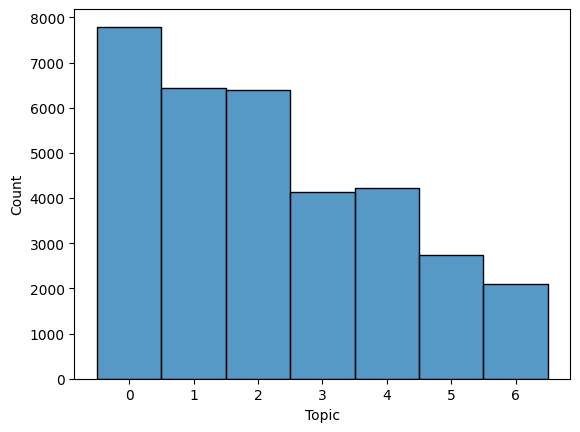

In [160]:
sns.histplot(results_final, x='Topic', discrete=True);

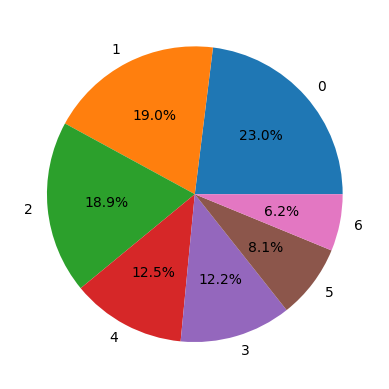

In [161]:
plt.pie(results_final.value_counts('Topic'), labels=results_final.value_counts('Topic').index, autopct='%1.1f%%');

In [ ]:
indices = [index for index, topic in enumerate(new_topics) if topic != -1]
corpus_valid = [tc1.corpus[i] for i in indices]
created_on_valid = [created_on[i] for i in indices]
embeddings_valid = [tc1.corpus_embeddings[i] for i in indices]
topics_valid = [new_topics[i] for i in indices]
probs_valid = [probs[i] for i in indices]

# Unisci i risultati con le informazioni sui topic
results = pd.DataFrame({
    'Document': corpus_valid,
    'Embedding': embeddings_valid,
    'Topic': topics_valid,
    'Probability': probs_valid
})
results_final = pd.merge(results, topic_model.get_topic_info(), on='Topic')

# Aggiungi le embeddings UMAP al DataFrame results_final
results_final['UMAP_embedding'] = list(X)
print(results_final.shape)
results_final.head()

### Grid Search

In [167]:
def topics_meet_criteria(topic_model, check_gun_topic=False):
    """
    Check if the topics meet the criteria for the assignment.
    :param topic_model: The BERTopic model used for clustering
    :param check_gun_topic: Whether to check for the gun topic
    :return: True if the topics meet the criteria, False otherwise
    """
    topics = topic_model.get_topics()
    drug_keywords = {'drug', 'cocaine', 'ketamine', 'weed', 'mdma', 'coke', 'lsd', 'heroine', 'xanax'}
    scam_bitcoin_keywords = {'transfer', 'bitcoin', 'wallet', 'paypal', 'bank'}
    market_keywords = {'market', 'vendor', 'darknet', 'scammer', 'scammed'}
    hacker_keywords = {'hacker', 'hack', 'exploit', 'exploited', 'exploitation', 'exploiting', 'exploiter', 'exploits'}
    gun_keywords = {'gun', 'firearm', 'pistol', 'rifle', 'shooting', 'weapon', 'handgun'}
    
    found_drug_topic = found_scam_bitcoin_topic = found_market_topic = found_hacker_topic = False
    drug_topic_id = scam_bitcoin_topic_id = market_topic_id = hacker_topic_id = None

    for topic_id, topic in topics.items():
        words = set([word for word, _ in topic])
        if words & drug_keywords:
            found_drug_topic = True
            drug_topic_id = topic_id
        if words & scam_bitcoin_keywords:
            found_scam_bitcoin_topic = True
            scam_bitcoin_topic_id = topic_id
        if words & market_keywords:
            found_market_topic = True
            market_topic_id = topic_id
        if words & hacker_keywords:
            found_hacker_topic = True
            hacker_topic_id = topic_id

    distinct_clusters = len(set(filter(None, [drug_topic_id, scam_bitcoin_topic_id, market_topic_id, hacker_topic_id])))

    if check_gun_topic:
        return (found_drug_topic and found_scam_bitcoin_topic and found_market_topic and found_hacker_topic and 
                distinct_clusters >= 4)
    
    return (found_drug_topic and found_scam_bitcoin_topic and found_market_topic and 
            distinct_clusters >= 3)

def cluster_size_within_threshold(topic_model, threshold=0.15):
    """
    Check if the sizes of the top 4 clusters are within the threshold.
    :param topic_model: The BERTopic model used for clustering
    :param threshold: The threshold for the size difference between the top 4 clusters
    :return: True if the sizes are within the threshold, False otherwise
    """
    topic_freq = topic_model.get_topic_freq()
    top_4_clusters = topic_freq.iloc[1:5]  # First row is for outliers

    for i in range(len(top_4_clusters) - 1):
        size_diff = abs(top_4_clusters.iloc[i]["Count"] - top_4_clusters.iloc[i + 1]["Count"])
        max_size = max(top_4_clusters.iloc[i]["Count"], top_4_clusters.iloc[i + 1]["Count"])
        if size_diff / max_size > threshold:
            return False

    return True

def compute_clustering_scores(topic_model, topics, embeddings):
    """
    Compute the silhouette score and Davies-Bouldin score for the clustering results.
    :param topic_model: The BERTopic model used for clustering
    :param topics: The topics assigned to each document
    :param embeddings: The embeddings of the documents
    :return: The silhouette score and Davies-Bouldin score
    """
    # Filter out outliers (cluster -1)
    valid_indices = [i for i, topic in enumerate(topics) if topic != -1]
    valid_embeddings = np.array([embeddings[i] for i in valid_indices])
    valid_topics = np.array([topics[i] for i in valid_indices])
    
    if len(set(valid_topics)) > 1:  # At least two clusters are needed to compute these scores
        silhouette = silhouette_score(valid_embeddings, valid_topics)
        davies_bouldin = davies_bouldin_score(valid_embeddings, valid_topics)
        return silhouette, davies_bouldin
    else:
        return -1, float('inf')
        
def grid_search_clusters(initial_model, initial_topics, target_outliers=25000, max_iters=10, cluster_size_threshold=0.20, min_silhouette=0.3):
    """
    Perform a grid search to find the optimal parameters for the BERTopic model.
    :param initial_model: The initial BERTopic model to start the search from
    :param initial_topics: The initial topics assigned by the model
    :param target_outliers: The target number of outliers to have in the final model
    :param max_iters: The maximum number of iterations to run the grid search for
    :param cluster_size_threshold: The threshold for the difference in cluster sizes
    :param min_silhouette: The minimum acceptable silhouette score
    :return: The best BERTopic model, the topics assigned by the model, and the probabilities of each topic
    """
    best_model = initial_model
    best_topics = initial_topics
    best_probs = None

    # Define parameter ranges for grid search
    n_neighbors_range = [5, 10, 15, 30, 50, 80]
    n_components_range = [2, 3, 5, 10]
    min_cluster_size_range = [900, 950, 1000, 1050, 1100, 1150, 1200, 1250, 1300]
    
    vectorizer_model = CountVectorizer(stop_words="english")
    representation_model = MaximalMarginalRelevance(diversity=0.3)
    ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True)

    iteration = 0
    log_file = "grid_search_log_hdbscan_min_cluster.csv"
    
    # Open log file and write headers
    with open(log_file, mode='w', newline='') as log_csv:
        log_writer = csv.writer(log_csv)
        log_writer.writerow(["min_cluster_size", "outliers", "silhouette", "davies_bouldin", "meets_criteria", "cluster_sizes", "representative_words"])

    # Start the grid search
    print(f"Iteration {iteration}: Adjusting parameters...")

    for min_clu in tqdm(min_cluster_size_range, desc="min_cluster_size"):
        # Configure UMAP model with current parameters
        umap_model = UMAP(n_neighbors=15, n_components=10, metric='cosine', random_state=42)
        
        hdbscan_model = hdbscan.HDBSCAN(min_cluster_size=min_clu, metric='euclidean', cluster_selection_method='eom', prediction_data=True)
        
        # Recreate BERTopic model with new parameters
        topic_model = BERTopic(
            language='multilingual',
            top_n_words=10,
            n_gram_range=(1, 2),
            verbose=True,
            umap_model=umap_model,
            hdbscan_model=hdbscan_model,
            seed_topic_list=seed_topic_list,
            vectorizer_model=vectorizer_model,
            representation_model=representation_model,
            ctfidf_model=ctfidf_model
        )
        
        # Refit the model
        topics, probs = topic_model.fit_transform(tc1.corpus, tc1.corpus_embeddings)
        
        # Calculate the number of outliers
        outlier_count = sum([1 if topic == -1 else 0 for topic in topics])
        
        # Compute clustering scores
        print("Computing clustering scores...")
        umap_embeddings = topic_model.umap_model.fit_transform(tc1.corpus_embeddings)
        indices = [index for index, topic in enumerate(topics) if topic != -1]
        X = umap_embeddings[np.array(indices)]
        labels = [topic for index, topic in enumerate(topics) if topic != -1]
        silhouette = silhouette_score(X, labels)
        davies_bouldin = davies_bouldin_score(X, labels)
        
        # Check if the configuration meets the criteria
        meets_criteria = topics_meet_criteria(topic_model)
        #cluster_size_within_threshold_flag = cluster_size_within_threshold(topic_model, cluster_size_threshold)
        
        # Get cluster sizes and representative words
        topic_info = topic_model.get_topic_info()
        cluster_sizes = topic_info['Count'].to_list()
        representative_words = [topic_model.get_topic(topic_id) for topic_id in topic_info['Topic'].to_list()]
        
        # Format representative words
        formatted_representative_words = [" ".join([word for word, _ in words]) for words in representative_words]

        # Log the current configuration
        with open(log_file, mode='a', newline='') as log_csv:
            log_writer = csv.writer(log_csv)
            log_writer.writerow([min_clu, outlier_count, silhouette, davies_bouldin, meets_criteria, cluster_sizes, formatted_representative_words])
                
    return best_model, best_topics, best_probs

In [168]:
topic_model, topics, probs = grid_search_clusters(topic_model, topics, target_outliers=25000)

Iteration 0: Adjusting parameters...


min_cluster_size:   0%|          | 0/9 [00:00<?, ?it/s]2024-06-25 22:56:58,790 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-06-25 22:59:09,533 - BERTopic - Dimensionality - Completed ✓
2024-06-25 22:59:09,684 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-06-25 23:00:31,591 - BERTopic - Cluster - Completed ✓
2024-06-25 23:00:32,067 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-06-25 23:00:37,564 - BERTopic - Representation - Completed ✓


Computing clustering scores...


min_cluster_size:  11%|█         | 1/9 [06:37<53:02, 397.84s/it]2024-06-25 23:03:37,490 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-06-25 23:06:05,972 - BERTopic - Dimensionality - Completed ✓
2024-06-25 23:06:05,988 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-06-25 23:08:07,288 - BERTopic - Cluster - Completed ✓
2024-06-25 23:08:07,918 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-06-25 23:08:12,953 - BERTopic - Representation - Completed ✓


Computing clustering scores...


min_cluster_size:  22%|██▏       | 2/9 [13:58<49:19, 422.84s/it]2024-06-25 23:10:59,067 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
